In [27]:
#Pre-Installs
!pip install --upgrade pip
!pip install lightgbm
import pandas as pd
#!pip install pdpbox
#!pip install matplotlib
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

  Using cached pip-23.3-py3-none-any.whl (2.1 MB)


ERROR: To modify pip, please run the following command:
C:\Users\Ishita.Agarwal\Anaconda3\python.exe -m pip install --upgrade pip

[notice] A new release of pip available: 22.2.2 -> 23.3
[notice] To update, run: python.exe -m pip install --upgrade pip



[notice] A new release of pip available: 22.2.2 -> 23.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [28]:
import warnings

# To suppress all warnings
warnings.filterwarnings('ignore')

In [29]:
!pip install pyspark


[notice] A new release of pip available: 22.2.2 -> 23.3
[notice] To update, run: python.exe -m pip install --upgrade pip


## Imports

In [30]:
import os
import sys
import scipy
import lightgbm
import numpy as np
import pandas as pd
import pickle

from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error

from pyspark.sql import functions as F
from pyspark.sql.window import Window
from pyspark.sql.types import IntegerType

pd.set_option('display.float.format', lambda x: '%.3f' % x)

In [31]:
!pip install openpyxl


[notice] A new release of pip available: 22.2.2 -> 23.3
[notice] To update, run: python.exe -m pip install --upgrade pip


In [32]:
df_model = pd.read_excel('efundementals_tesco_data_complete.xlsx')
print(df_model.shape)


(26091, 78)


In [33]:
#df_model['BRAND']=np.where(df_model["GTIN"]=="90715043","Mars")
# df_model.loc[df_model['GTIN']=="90715043", 'BRAND'] = 'Mars'
# df_model=df_model.drop_duplicates()
print(df_model.shape)

(26091, 78)


In [34]:
# for col in ["Last 30 days paid_count","Last 30 days promotion_count","Days_since_last_promotion","LAST_1_WEEK_SALES_new","LAST_8_WEEK_SALES_new","LAST_16_WEEK_SALES_new"]:
#   df_model[col]=df_model[col].fillna(0)
### commented by sahil

In [35]:
# df_model["Last 30 days paid_count"]=df_model["Last 30 days paid_count"].fillna(0)
# df_model["Days_since_last_paid"]=df_model["Days_since_last_paid"].fillna(30) ## commented by sahil
#df_model["Last 30 days_continous"]=df_model["Last 30 days_continous"].fillna(0)

df_model['AV_OOS'].unique()

array(['AVAILABLE', 'OOS'], dtype=object)

In [36]:
df_model.columns

Index(['GTIN', 'GATHERED_DATE', 'SR_SEARCH_TERM', 'SR_PAID_SEARCH', 'SR_RANK',
       'RETAILER', 'WEEK_ENDING_DATE', 'MANUFACTURER', 'BRAND',
       'SR_PARSED_PRICE', 'SR_AVG_RANK', 'SR_count', 'COMP_BASICS_SCORE',
       'COMP_COMPLIANCE_SCORE', 'COMP_SCORE_NAME', 'COMP_SCORE_PRICE',
       'COMP_SCORE_DESCRIPTION', 'COMP_SCORE_NET_QUANTITY',
       'COMP_SCORE_INGREDIENTS', 'COMP_SCORE_NUTRITION', 'COMP_SCORE_STORAGE',
       'COMP_SCORE_MANUFACTURER', 'COMP_SCORE_COUNTRY', 'COMP_SCORE_WSP_RSP',
       'COMP_SCORE_WSP_POR', 'COMP_SCORE_WSP_VAT', 'COMP_SCORE_WSP_INC_VAT',
       'COMP_SCORE_IMAGE', 'FB_FEEDBACK_AVG_RATING',
       'FB_FEEDBACK_RECOMMENDATION', 'COMP_HAS_RICH_CONTENT',
       'COMP_VIDEO_COUNT', 'COMP_IMG_COUNT', 'COMP_TITLE_LENGTH',
       'COMP_DESCRIPTION_LENGTH', 'FB_FEEDBACK_COMMENT_COUNT',
       'SR_PROMOTION_TYPE', 'Clubcard_flag', 'COMP_RETAILER_PRODUCT_NAME',
       'COMP_DESCRIPTION', 'COMP_SELLER_TYPE', 'AV_OOS', 'PR_SUBSCRIPTION',
       'SEARCH_TERM_IN_

In [37]:
df_model.head()

,GTIN,GATHERED_DATE,SR_SEARCH_TERM,SR_PAID_SEARCH,SR_RANK,RETAILER,WEEK_ENDING_DATE,MANUFACTURER,BRAND,SR_PARSED_PRICE,SR_AVG_RANK,SR_count,COMP_BASICS_SCORE,COMP_COMPLIANCE_SCORE,COMP_SCORE_NAME,COMP_SCORE_PRICE,COMP_SCORE_DESCRIPTION,COMP_SCORE_NET_QUANTITY,COMP_SCORE_INGREDIENTS,COMP_SCORE_NUTRITION,COMP_SCORE_STORAGE,COMP_SCORE_MANUFACTURER,COMP_SCORE_COUNTRY,COMP_SCORE_WSP_RSP,COMP_SCORE_WSP_POR,COMP_SCORE_WSP_VAT,COMP_SCORE_WSP_INC_VAT,COMP_SCORE_IMAGE,FB_FEEDBACK_AVG_RATING,FB_FEEDBACK_RECOMMENDATION,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,SR_PROMOTION_TYPE,Clubcard_flag,COMP_RETAILER_PRODUCT_NAME,COMP_DESCRIPTION,COMP_SELLER_TYPE,AV_OOS,PR_SUBSCRIPTION,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Seasonal_sku,NIELSEN_END_DATE,PACK_TYPE,GRAMMAGE,Retailer_Margin,Spends,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_2_WEEK_SALES,LAST_4_WEEK_SALES,LAST_8_WEEK_SALES,LAST_16_WEEK_SALES,CHRISTMAS,EASTER,HALLOWEEN,VALENTINE,HOLIDAY_FLAG,HOL_PRE,HOL_FORT,HOL_POST,SEARCH_TERM_IN_TITLE_FW_SCORE,SEARCH_TERM_IN_DESC_FW_SCORE,SEARCH_TERM_FW_POS_IN_TITLE,SEARCH_TERM_LENGTH,SEARCH_TERM_WORD_COUNT,SEARCH_TERM_EXACT_POS_IN_TITLE,DAY_OF_WEEK,WEEK_OF_YEAR,SHARE_OF_SALES,RETAILER_MARGIN_PERCENT
0,GTIN1,2022-01-11,funsize,0,3,A,2022-01-15,B,Brand1,1.490,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-01-15,Packaged,197.000,0.344,0.000,12022.810,8069,14704,18258,31239,57090,347313,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,2,0.028,0.000
1,GTIN1,2022-05-10,funsize,0,3,A,2022-05-14,B,Brand1,2.200,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-05-14,Packaged,197.000,0.428,293.290,12086.800,5494,9844,13362,19692,36922,107899,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,19,0.028,0.000
2,GTIN1,2022-03-09,funsize,0,3,A,2022-03-12,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-03-12,Packaged,197.000,0.494,55.983,18222.000,7273,22697,37471,52987,79046,128067,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Wednesday,10,0.028,0.000
3,GTIN1,2022-01-24,funsize,0,3,A,2022-01-29,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-01-29,Packaged,197.000,0.673,0.000,14210.640,4755,13198,21267,31456,60040,232850,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Monday,4,0.028,0.000
4,GTIN1,2022-04-01,fun size,0,3,A,2022-04-02,B,Brand1,3.000,1,471,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,1,1,1,1,0,2022-04-02,Packaged,197.000,-1.824,23.609,13047.000,4349,8716,13083,35780,70862,124792,0,1,0,0,1,1,0,0,90,60,2,8,2,10,Friday,13,0.028,-0.000


In [38]:
df_model['GROWTH_4_WEEK']=(df_model['LAST_2_WEEK_SALES']-df_model['LAST_1_WEEK_SALES'])/df_model['LAST_4_WEEK_SALES']
df_model['GROWTH_8_WEEK']=(df_model['LAST_2_WEEK_SALES']-df_model['LAST_1_WEEK_SALES'])/df_model['LAST_8_WEEK_SALES']
df_model['GROWTH_16_WEEK']=(df_model['LAST_2_WEEK_SALES']-df_model['LAST_1_WEEK_SALES'])/df_model['LAST_16_WEEK_SALES']

In [39]:
df_model.head()

,GTIN,GATHERED_DATE,SR_SEARCH_TERM,SR_PAID_SEARCH,SR_RANK,RETAILER,WEEK_ENDING_DATE,MANUFACTURER,BRAND,SR_PARSED_PRICE,SR_AVG_RANK,SR_count,COMP_BASICS_SCORE,COMP_COMPLIANCE_SCORE,COMP_SCORE_NAME,COMP_SCORE_PRICE,COMP_SCORE_DESCRIPTION,COMP_SCORE_NET_QUANTITY,COMP_SCORE_INGREDIENTS,COMP_SCORE_NUTRITION,COMP_SCORE_STORAGE,COMP_SCORE_MANUFACTURER,COMP_SCORE_COUNTRY,COMP_SCORE_WSP_RSP,COMP_SCORE_WSP_POR,COMP_SCORE_WSP_VAT,COMP_SCORE_WSP_INC_VAT,COMP_SCORE_IMAGE,FB_FEEDBACK_AVG_RATING,FB_FEEDBACK_RECOMMENDATION,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,SR_PROMOTION_TYPE,Clubcard_flag,COMP_RETAILER_PRODUCT_NAME,COMP_DESCRIPTION,COMP_SELLER_TYPE,AV_OOS,PR_SUBSCRIPTION,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Seasonal_sku,NIELSEN_END_DATE,PACK_TYPE,GRAMMAGE,Retailer_Margin,Spends,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_2_WEEK_SALES,LAST_4_WEEK_SALES,LAST_8_WEEK_SALES,LAST_16_WEEK_SALES,CHRISTMAS,EASTER,HALLOWEEN,VALENTINE,HOLIDAY_FLAG,HOL_PRE,HOL_FORT,HOL_POST,SEARCH_TERM_IN_TITLE_FW_SCORE,SEARCH_TERM_IN_DESC_FW_SCORE,SEARCH_TERM_FW_POS_IN_TITLE,SEARCH_TERM_LENGTH,SEARCH_TERM_WORD_COUNT,SEARCH_TERM_EXACT_POS_IN_TITLE,DAY_OF_WEEK,WEEK_OF_YEAR,SHARE_OF_SALES,RETAILER_MARGIN_PERCENT,GROWTH_4_WEEK,GROWTH_8_WEEK,GROWTH_16_WEEK
0,GTIN1,2022-01-11,funsize,0,3,A,2022-01-15,B,Brand1,1.490,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-01-15,Packaged,197.000,0.344,0.000,12022.810,8069,14704,18258,31239,57090,347313,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,2,0.028,0.000,0.114,0.062,0.010
1,GTIN1,2022-05-10,funsize,0,3,A,2022-05-14,B,Brand1,2.200,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-05-14,Packaged,197.000,0.428,293.290,12086.800,5494,9844,13362,19692,36922,107899,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,19,0.028,0.000,0.179,0.095,0.033
2,GTIN1,2022-03-09,funsize,0,3,A,2022-03-12,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-03-12,Packaged,197.000,0.494,55.983,18222.000,7273,22697,37471,52987,79046,128067,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Wednesday,10,0.028,0.000,0.279,0.187,0.115
3,GTIN1,2022-01-24,funsize,0,3,A,2022-01-29,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,0,0,0,0,0,2022-01-29,Packaged,197.000,0.673,0.000,14210.640,4755,13198,21267,31456,60040,232850,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Monday,4,0.028,0.000,0.257,0.134,0.035
4,GTIN1,2022-04-01,fun size,0,3,A,2022-04-02,B,Brand1,3.000,1,471,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,AVAILABLE,NOT AVAILABLE,1,1,1,1,0,2022-04-02,Packaged,197.000,-1.824,23.609,13047.000,4349,8716,13083,35780,70862,124792,0,1,0,0,1,1,0,0,90,60,2,8,2,10,Friday,13,0.028,-0.000,0.122,0.062,0.035


In [40]:
cat_cols=['AV_OOS','PACK_TYPE','PR_SUBSCRIPTION'
          ]

df_model = pd.get_dummies(df_model, columns=cat_cols)
df_model.head()

,GTIN,GATHERED_DATE,SR_SEARCH_TERM,SR_PAID_SEARCH,SR_RANK,RETAILER,WEEK_ENDING_DATE,MANUFACTURER,BRAND,SR_PARSED_PRICE,SR_AVG_RANK,SR_count,COMP_BASICS_SCORE,COMP_COMPLIANCE_SCORE,COMP_SCORE_NAME,COMP_SCORE_PRICE,COMP_SCORE_DESCRIPTION,COMP_SCORE_NET_QUANTITY,COMP_SCORE_INGREDIENTS,COMP_SCORE_NUTRITION,COMP_SCORE_STORAGE,COMP_SCORE_MANUFACTURER,COMP_SCORE_COUNTRY,COMP_SCORE_WSP_RSP,COMP_SCORE_WSP_POR,COMP_SCORE_WSP_VAT,COMP_SCORE_WSP_INC_VAT,COMP_SCORE_IMAGE,FB_FEEDBACK_AVG_RATING,FB_FEEDBACK_RECOMMENDATION,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,SR_PROMOTION_TYPE,Clubcard_flag,COMP_RETAILER_PRODUCT_NAME,COMP_DESCRIPTION,COMP_SELLER_TYPE,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Seasonal_sku,NIELSEN_END_DATE,GRAMMAGE,Retailer_Margin,Spends,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_2_WEEK_SALES,LAST_4_WEEK_SALES,LAST_8_WEEK_SALES,LAST_16_WEEK_SALES,CHRISTMAS,EASTER,HALLOWEEN,VALENTINE,HOLIDAY_FLAG,HOL_PRE,HOL_FORT,HOL_POST,SEARCH_TERM_IN_TITLE_FW_SCORE,SEARCH_TERM_IN_DESC_FW_SCORE,SEARCH_TERM_FW_POS_IN_TITLE,SEARCH_TERM_LENGTH,SEARCH_TERM_WORD_COUNT,SEARCH_TERM_EXACT_POS_IN_TITLE,DAY_OF_WEEK,WEEK_OF_YEAR,SHARE_OF_SALES,RETAILER_MARGIN_PERCENT,GROWTH_4_WEEK,GROWTH_8_WEEK,GROWTH_16_WEEK,AV_OOS_AVAILABLE,AV_OOS_OOS,PACK_TYPE_Boxed Chocolate,PACK_TYPE_Multipack,PACK_TYPE_Packaged,PACK_TYPE_Premium Selection,PACK_TYPE_Single,PR_SUBSCRIPTION_NOT AVAILABLE
0,GTIN1,2022-01-11,funsize,0,3,A,2022-01-15,B,Brand1,1.490,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,0,0,0,0,0,2022-01-15,197.000,0.344,0.000,12022.810,8069,14704,18258,31239,57090,347313,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,2,0.028,0.000,0.114,0.062,0.010,1,0,0,0,1,0,0,1
1,GTIN1,2022-05-10,funsize,0,3,A,2022-05-14,B,Brand1,2.200,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,0,0,0,0,0,2022-05-14,197.000,0.428,293.290,12086.800,5494,9844,13362,19692,36922,107899,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Tuesday,19,0.028,0.000,0.179,0.095,0.033,1,0,0,0,1,0,0,1
2,GTIN1,2022-03-09,funsize,0,3,A,2022-03-12,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,0,0,0,0,0,2022-03-12,197.000,0.494,55.983,18222.000,7273,22697,37471,52987,79046,128067,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Wednesday,10,0.028,0.000,0.279,0.187,0.115,1,0,0,0,1,0,0,1
3,GTIN1,2022-01-24,funsize,0,3,A,2022-01-29,B,Brand1,3.000,1,468,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,NaN,0,0,0,0,0,2022-01-29,197.000,0.673,0.000,14210.640,4755,13198,21267,31456,60040,232850,0,0,0,0,0,0,0,0,77,52,2,7,1,-1,Monday,4,0.028,0.000,0.257,0.134,0.035,1,0,0,0,1,0,0,1
4,GTIN1,2022-04-01,fun size,0,3,A,2022-04-02,B,Brand1,3.000,1,471,76,71,72,100,100,100,100,100,0,100.000,0.000,NaN,NaN,NaN,NaN,33,3.700,NaN,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,NaN,1,1,1,1,0,2022-04-02,197.000,-1.824,23.609,13047.000,4349,8716,13083,35780,70862,124792,0,1,0,0,1,1,0,0,90,60,2,8,2,10,Friday,13,0.028,-0.000,0.122,0.062,0.035,1,0,0,0,1,0,0,1


In [41]:
df_model.columns

Index(['GTIN', 'GATHERED_DATE', 'SR_SEARCH_TERM', 'SR_PAID_SEARCH', 'SR_RANK',
       'RETAILER', 'WEEK_ENDING_DATE', 'MANUFACTURER', 'BRAND',
       'SR_PARSED_PRICE', 'SR_AVG_RANK', 'SR_count', 'COMP_BASICS_SCORE',
       'COMP_COMPLIANCE_SCORE', 'COMP_SCORE_NAME', 'COMP_SCORE_PRICE',
       'COMP_SCORE_DESCRIPTION', 'COMP_SCORE_NET_QUANTITY',
       'COMP_SCORE_INGREDIENTS', 'COMP_SCORE_NUTRITION', 'COMP_SCORE_STORAGE',
       'COMP_SCORE_MANUFACTURER', 'COMP_SCORE_COUNTRY', 'COMP_SCORE_WSP_RSP',
       'COMP_SCORE_WSP_POR', 'COMP_SCORE_WSP_VAT', 'COMP_SCORE_WSP_INC_VAT',
       'COMP_SCORE_IMAGE', 'FB_FEEDBACK_AVG_RATING',
       'FB_FEEDBACK_RECOMMENDATION', 'COMP_HAS_RICH_CONTENT',
       'COMP_VIDEO_COUNT', 'COMP_IMG_COUNT', 'COMP_TITLE_LENGTH',
       'COMP_DESCRIPTION_LENGTH', 'FB_FEEDBACK_COMMENT_COUNT',
       'SR_PROMOTION_TYPE', 'Clubcard_flag', 'COMP_RETAILER_PRODUCT_NAME',
       'COMP_DESCRIPTION', 'COMP_SELLER_TYPE', 'SEARCH_TERM_IN_NAME',
       'SEARCH_TERM_COUNT_IN_

In [42]:
exclude_cols = ["RETAILER",
      "SR_count",
      "FB_FEEDBACK_RECOMMENDATION",
      # "FB_FEEDBACK_COMMENT_COUNT",
      # "FB_FEEDBACK_AVG_RATING",
      "COMP_SCORE_WSP_INC_VAT",
      "COMP_SCORE_WSP_VAT",
      "COMP_SCORE_WSP_POR",
      "COMP_SCORE_WSP_RSP",
      "COMP_SCORE_COUNTRY",
      "COMP_SCORE_PRICE",
      "COMP_SCORE_MANUFACTURER",
      "COMP_SELLER_TYPE",
      # "COMP_VIDEO_COUNT",
      "COMP_SCORE_STORAGE",
      # "COMP_IMG_COUNT",
      "COMP_SCORE_DESCRIPTION",
      # "COMP_HAS_RICH_CONTENT",
      "COMP_SCORE_INGREDIENTS",
      "COMP_SCORE_NET_QUANTITY",
      "COMP_SCORE_NAME",
      "COMP_SCORE_NUTRITION",
      "COMP_BASICS_SCORE",
      "COMP_COMPLIANCE_SCORE",
      # "PR_SUBSCRIPTION",
      # "RETAIL_SALES_VALUE",
      # "RETAIL_SALES_UNIT",
      "NIELSEN_END_DATE",
#       "EAN",
      "MANUFACTURER",
      "WEEK_ENDING_DATE",
      "SR_AVG_RANK",
      'LAST_2_WEEK_SALES',
      "LAST_4_WEEK_SALES",
      'LAST_16_WEEK_SALES',
      # "SEARCH_TERM_IN_DESC",
      # "SEARCH_TERM_IN_NAME",
      "SEARCH_TERM_EXACT_POS_IN_TITLE",
      "Spends",
      "HOL_PRE",
      "HOL_POST",
      "HOL_FORT",
      # "HOLIDAY_FLAG",
      "SHARE_OF_SALES","RETAILER_MARGIN_PERCENT","SEARCH_TERM_LENGTH","DAY_OF_WEEK","GRAMMAGE", 'Seasonal_sku','SEARCH_TERM_WORD_COUNT', 'COMP_SCORE_IMAGE','SEARCH_TERM_IN_DESC_FW_SCORE','CHRISTMAS','EASTER','HALLOWEEN','VALENTINE',
                'SEARCH_TERM_IN_TITLE_FW_SCORE','WEEK_OF_YEAR']

include_cols = ['SR_RANK','SR_PARSED_PRICE','COMP_TITLE_LENGTH','COMP_DESCRIPTION_LENGTH',"COMP_VIDEO_COUNT",
                "COMP_IMG_COUNT","COMP_HAS_RICH_CONTENT", "RETAIL_SALES_VALUE", 
                'SEARCH_TERM_IN_NAME',"SEARCH_TERM_IN_DESC",'SEARCH_TERM_COUNT_IN_NAME','SEARCH_TERM_COUNT_IN_DESC','SEARCH_TERM_FW_POS_IN_TITLE', 'Retailer_Margin',

      "HOLIDAY_FLAG",
      "FB_FEEDBACK_COMMENT_COUNT",
      "FB_FEEDBACK_AVG_RATING",'AV_OOS_AVAILABLE', 'AV_OOS_OOS','GROWTH_16_WEEK'

      # 'GROWTH_4_WEEK','GROWTH_8_WEEK',

      # 'LAST_1_WEEK_SALES',"RETAIL_SALES_UNIT",
      # 'LAST_2_WEEK_SALES',
      # "LAST_4_WEEK_SALES","LAST_8_WEEK_SALES",
      # 'LAST_16_WEEK_SALES',

      #  'PACK_TYPE_Boxed Chocolate', 'PACK_TYPE_Multipack',
      #  'PACK_TYPE_Packaged', 'PACK_TYPE_Premium Selection',
      #  'PACK_TYPE_Single','PR_SUBSCRIPTION_NOT AVAILABLE'

      
      # 'BRAND','AV_OOS', 'PACK_TYPE',"PR_SUBSCRIPTION"
                ## columns commented by sahil
#                 'Last 30 days paid_count',
#        'Days_since_last_paid',"NO_PROMOTION",'Last 30 days promotion_count', 'Days_since_last_promotion',
      #  'LAST_1_WEEK_SALES_new', 'LAST_8_WEEK_SALES_new',
      #  'LAST_16_WEEK_SALES_new',
      #  "Discount_Depth_tmp"
      #  'COUPON_PROMOTION','Clubcard_flag',
      #  'PRICE_CUT_PROMOTION', 'BUNDLE_PROMOTION'
                #,'CATEGORY',"SR_PAID_SEARCH","SR_PROMOTION_TYPE", 'Last 30 days_continous','LAST_16_WEEK_SALES'
]



In [43]:
# exclude_cols = ["RETAILER",
#       "SR_count",
#       "FB_FEEDBACK_RECOMMENDATION",
#       "FB_FEEDBACK_COMMENT_COUNT",
#       "FB_FEEDBACK_AVG_RATING",
#       "COMP_SCORE_WSP_INC_VAT",
#       "COMP_SCORE_WSP_VAT",
#       "COMP_SCORE_WSP_POR",
#       "COMP_SCORE_WSP_RSP",
#       "COMP_SCORE_COUNTRY",
#       "COMP_SCORE_PRICE",
#       "COMP_SCORE_MANUFACTURER",
#       "COMP_SELLER_TYPE",
#       "COMP_VIDEO_COUNT",
#       "COMP_SCORE_STORAGE",
#       "COMP_IMG_COUNT",
#       "COMP_SCORE_DESCRIPTION",
#       "COMP_HAS_RICH_CONTENT",
#       "COMP_SCORE_INGREDIENTS",
#       "COMP_SCORE_NET_QUANTITY",
#       "COMP_SCORE_NAME",
#       "COMP_SCORE_NUTRITION",
#       "COMP_BASICS_SCORE",
#       "COMP_COMPLIANCE_SCORE",
#       "PR_SUBSCRIPTION",
#       "RETAIL_SALES_VALUE",
#       "RETAIL_SALES_UNIT",
#       "NIELSEN_END_DATE",
# #       "EAN", sahil
#       "MANUFACTURER",
#       "WEEK_ENDING_DATE",
#       "SR_AVG_RANK",
#       'LAST_2_WEEK_SALES',
#       "LAST_4_WEEK_SALES",
#       'LAST_16_WEEK_SALES',
#       "SEARCH_TERM_IN_DESC",
#       "SEARCH_TERM_IN_NAME",
#       "SEARCH_TERM_EXACT_POS_IN_TITLE",
#       "Spends",
#       "HOL_PRE",
#       "HOL_POST",
#       "HOL_FORT",
#       "HOLIDAY_FLAG","SHARE_OF_SALES","RETAILER_MARGIN_PERCENT","SEARCH_TERM_LENGTH","DAY_OF_WEEK","GRAMMAGE", 'Seasonal_sku','SEARCH_TERM_WORD_COUNT']

# include_cols = ['SR_RANK','SR_PARSED_PRICE','COMP_SCORE_IMAGE','COMP_TITLE_LENGTH','COMP_DESCRIPTION_LENGTH',
#                 'SEARCH_TERM_COUNT_IN_NAME','SEARCH_TERM_COUNT_IN_DESC','CHRISTMAS','EASTER','HALLOWEEN','VALENTINE',
#                 'SEARCH_TERM_IN_TITLE_FW_SCORE','SEARCH_TERM_IN_DESC_FW_SCORE','SEARCH_TERM_FW_POS_IN_TITLE',
#                 'WEEK_OF_YEAR','AV_OOS','BRAND', 'PACK_TYPE', 'Retailer_Margin',
#                 ## columns commented by sahil
# #                 'Last 30 days paid_count',
# #        'Days_since_last_paid',"NO_PROMOTION",'Last 30 days promotion_count', 'Days_since_last_promotion',
# #        'LAST_1_WEEK_SALES_new', 'LAST_8_WEEK_SALES_new',
# #        'LAST_16_WEEK_SALES_new',"Discount_Depth_tmp"
#       #  'COUPON_PROMOTION','Clubcard_flag',
#       #  'PRICE_CUT_PROMOTION', 'BUNDLE_PROMOTION'
#                 #,'CATEGORY',"SR_PAID_SEARCH","SR_PROMOTION_TYPE", 'Last 30 days_continous','LAST_16_WEEK_SALES'
# ]



In [44]:
#Check any cols missed 
print('Columns Missed:',set(df_model.columns)-set(include_cols)-set(exclude_cols))

Columns Missed: {'PACK_TYPE_Multipack', 'SR_SEARCH_TERM', 'COMP_RETAILER_PRODUCT_NAME', 'RETAIL_SALES_UNIT', 'PACK_TYPE_Packaged', 'PACK_TYPE_Single', 'GROWTH_8_WEEK', 'GTIN', 'LAST_8_WEEK_SALES', 'BRAND', 'PACK_TYPE_Premium Selection', 'GROWTH_4_WEEK', 'SR_PAID_SEARCH', 'PACK_TYPE_Boxed Chocolate', 'LAST_1_WEEK_SALES', 'GATHERED_DATE', 'Clubcard_flag', 'SR_PROMOTION_TYPE', 'PR_SUBSCRIPTION_NOT AVAILABLE', 'COMP_DESCRIPTION'}


In [45]:
#Drop Exclude columns
df_model.drop(columns=exclude_cols,inplace=True)

In [46]:
df_model.head(3)

,GTIN,GATHERED_DATE,SR_SEARCH_TERM,SR_PAID_SEARCH,SR_RANK,BRAND,SR_PARSED_PRICE,FB_FEEDBACK_AVG_RATING,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,SR_PROMOTION_TYPE,Clubcard_flag,COMP_RETAILER_PRODUCT_NAME,COMP_DESCRIPTION,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Retailer_Margin,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_8_WEEK_SALES,HOLIDAY_FLAG,SEARCH_TERM_FW_POS_IN_TITLE,GROWTH_4_WEEK,GROWTH_8_WEEK,GROWTH_16_WEEK,AV_OOS_AVAILABLE,AV_OOS_OOS,PACK_TYPE_Boxed Chocolate,PACK_TYPE_Multipack,PACK_TYPE_Packaged,PACK_TYPE_Premium Selection,PACK_TYPE_Single,PR_SUBSCRIPTION_NOT AVAILABLE
0,GTIN1,2022-01-11,funsize,0,3,Brand1,1.490,3.700,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.344,12022.810,8069,14704,57090,0,2,0.114,0.062,0.010,1,0,0,0,1,0,0,1
1,GTIN1,2022-05-10,funsize,0,3,Brand1,2.200,3.700,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.428,12086.800,5494,9844,36922,0,2,0.179,0.095,0.033,1,0,0,0,1,0,0,1
2,GTIN1,2022-03-09,funsize,0,3,Brand1,3.000,3.700,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.494,18222.000,7273,22697,79046,0,2,0.279,0.187,0.115,1,0,0,0,1,0,0,1


In [47]:
deciles = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9,0.95,0.99,1]
for i in df_model.columns:
    if i in include_cols:
        print(i)
        print(df_model[i].quantile(deciles))




SR_RANK
0.100    2.000
0.200    3.000
0.300    5.000
0.400    8.000
0.500   12.000
0.600   15.000
0.700   18.000
0.800   20.000
0.900   23.000
0.950   24.000
0.990   26.000
1.000   26.000
Name: SR_RANK, dtype: float64
SR_PARSED_PRICE
0.100   1.240
0.200   1.250
0.300   1.250
0.400   1.350
0.500   1.500
0.600   1.990
0.700   2.250
0.800   3.000
0.900   3.500
0.950   5.000
0.990   5.000
1.000   7.000
Name: SR_PARSED_PRICE, dtype: float64
FB_FEEDBACK_AVG_RATING
0.100   2.700
0.200   3.400
0.300   4.000
0.400   4.100
0.500   4.400
0.600   4.700
0.700   4.800
0.800   5.000
0.900   5.000
0.950   5.000
0.990   5.000
1.000   5.000
Name: FB_FEEDBACK_AVG_RATING, dtype: float64
COMP_HAS_RICH_CONTENT
0.100   0.000
0.200   0.000
0.300   0.000
0.400   0.000
0.500   0.000
0.600   0.000
0.700   0.000
0.800   0.000
0.900   0.000
0.950   0.000
0.990   0.000
1.000   0.000
Name: COMP_HAS_RICH_CONTENT, dtype: float64
COMP_VIDEO_COUNT
0.100   0.000
0.200   0.000
0.300   0.000
0.400   0.000
0.500   0.000
0.6

In [48]:
# pd.DataFrame(df_model.columns).to_csv('/dbfs/mnt/adls-gen2/SmartDataLake/Temp/Sahil/current_columns.csv')

In [49]:
df_model.dtypes

GTIN                                     object
GATHERED_DATE                    datetime64[ns]
SR_SEARCH_TERM                           object
SR_PAID_SEARCH                            int64
SR_RANK                                   int64
BRAND                                    object
SR_PARSED_PRICE                         float64
FB_FEEDBACK_AVG_RATING                  float64
COMP_HAS_RICH_CONTENT                     int64
COMP_VIDEO_COUNT                          int64
COMP_IMG_COUNT                            int64
COMP_TITLE_LENGTH                         int64
COMP_DESCRIPTION_LENGTH                   int64
FB_FEEDBACK_COMMENT_COUNT               float64
SR_PROMOTION_TYPE                        object
Clubcard_flag                             int64
COMP_RETAILER_PRODUCT_NAME               object
COMP_DESCRIPTION                         object
SEARCH_TERM_IN_NAME                       int64
SEARCH_TERM_COUNT_IN_NAME                 int64
SEARCH_TERM_IN_DESC                     

In [50]:
df_model.dtypes[df_model.dtypes=='object']

GTIN                          object
SR_SEARCH_TERM                object
BRAND                         object
SR_PROMOTION_TYPE             object
COMP_RETAILER_PRODUCT_NAME    object
COMP_DESCRIPTION              object
dtype: object

In [51]:
# Null to 0
# df_model.loc[:,'oos'] = df_model['oos'].fillna(100)
# df_model.loc[:,'Promotion'] = df_model['Promotion'].fillna('NA')
cat_cols=['AV_OOS_AVAILABLE', 'AV_OOS_OOS'
      #  'PACK_TYPE_Boxed Chocolate', 'PACK_TYPE_Multipack',
      #  'PACK_TYPE_Packaged', 'PACK_TYPE_Premium Selection',
      #  'PACK_TYPE_Single','PR_SUBSCRIPTION_NOT AVAILABLE'
      #  'AV_OOS', 'PACK_TYPE',
          #'BRAND','CATEGORY','SR_PAID_SEARCH'
          ]
# na_cols=list((df_model.isna().sum())[(df_model.isna().sum()>0).values].index)
# df_model[na_cols]=df_model[na_cols].fillna(0.0)

# for c in cat_cols :
#   df_model.loc[:, c] = pd.Series(df_model.loc[:, c], dtype="category") # commented by sahil
df_model.loc[:, "GTIN"] = pd.Series(df_model["GTIN"].astype(str), dtype="category")
#num_cols = df_model.columns[df_model.dtypes == np.float]
#df_model[num_cols] = df_model[num_cols].fillna(0)
# Taking Log of Target Variable
#df_model.loc[:, "Dependent"] = np.log(df_model.loc[:, "Dependent"])
df_model.isna().sum()

GTIN                               0
GATHERED_DATE                      0
SR_SEARCH_TERM                     0
SR_PAID_SEARCH                     0
SR_RANK                            0
BRAND                              0
SR_PARSED_PRICE                    2
FB_FEEDBACK_AVG_RATING           431
COMP_HAS_RICH_CONTENT              0
COMP_VIDEO_COUNT                   0
COMP_IMG_COUNT                     0
COMP_TITLE_LENGTH                  0
COMP_DESCRIPTION_LENGTH            0
FB_FEEDBACK_COMMENT_COUNT        431
SR_PROMOTION_TYPE                  0
Clubcard_flag                      0
COMP_RETAILER_PRODUCT_NAME         0
COMP_DESCRIPTION                   0
SEARCH_TERM_IN_NAME                0
SEARCH_TERM_COUNT_IN_NAME          0
SEARCH_TERM_IN_DESC                0
SEARCH_TERM_COUNT_IN_DESC          0
Retailer_Margin                    0
RETAIL_SALES_VALUE                 0
RETAIL_SALES_UNIT                  0
LAST_1_WEEK_SALES                  0
LAST_8_WEEK_SALES                  0
H

In [52]:
def print_metrics(actual, prediction):
    
  slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(actual, prediction)
  r2 = r2_score(actual, prediction)
  adjusted_r2 = 1 - (1 - r2) * (len(actual) - 1) / (len(actual) - model_x_train.shape[1] - 1)
  mae = mean_absolute_error(actual, prediction)
  mape = np.mean(np.abs(actual - prediction)/actual)
  wmape = np.sum(np.abs(actual - prediction))/actual.sum()
  # print(f"r2\t: {r2:.4f}\nAdj R2\t: {adjusted_r2:.4f}\n")
  print(f"MAE\t: {mae:.4f}\nMAPE\t: {mape:.4f}\nW-MAPE\t: {wmape:.4f}\nR2\t: {r2:.4f}")

In [53]:
# GRID SEARCH
def get_best_params(model_x_train, model_y_train):
    from sklearn.model_selection import GridSearchCV

    model = lightgbm.LGBMRegressor()

    param_dist = {
      "max_depth"           : np.arange(7, 12, 1),
      "learning_rate"       : np.arange(0.02, 0.06, 0.004),
      "num_leaves"          : [32,40,56,64,128,256],
      "n_estimators"        : np.arange(500, 600, 10),

      "boosting_type"       : ["gbdt"],
      "random_state"        : [42],
      "objective"           : ["regression"]
      # these parameters are commented by sahil

      # "max_depth"           : np.arange(7, 12, 1),
      # "learning_rate"       : np.arange(0.02,0.06),
      # "num_leaves"          : [32,40],
      # "n_estimators"        : np.arange(500,600,10),

      # "boosting_type"       : ["gbdt"],
      # "random_state"        : [42],
      # "objective"           : ["regression"]

      # "max_bin"             : [64,128,256],
      # "learning_rate"       : [0.01, 0.02, 0.03, 0.04, 0.05, 0.06, 0.1, 0.2],
      # "num_leaves"          : np.logspace(start= 1, stop =10,  num=10, base=2),
      # "max_bin"             : np.logspace(start= 1, stop =8,  num=8, base=2),
      # "min_child_samples"   : np.arange(10, 100, 10),
      # "colsample_bytree"    : np.arange(.1, 1, .1),
      # "min_data_in_leaf"    : []
    }

    grid_search = GridSearchCV(model, param_grid=param_dist, verbose = 10, n_jobs = -1, cv = 3)
    grid_search.fit(model_x_train, model_y_train)
    print("max_depth_best:\t",grid_search.best_estimator_.max_depth)
    print("num_leaves_best:\t",grid_search.best_estimator_.num_leaves)
    print("learning_rate_best:\t",grid_search.best_estimator_.learning_rate)
    print("n_estimators_best:\t",grid_search.best_estimator_.n_estimators)

    #print("max_bin_best:\t",grid_search.best_estimator_.max_bin)
    print("min_child_samples_best:\t", grid_search.best_estimator_.min_child_samples)
    print("colsample_bytree_best:\t", grid_search.best_estimator_.colsample_bytree)
    return grid_search.best_estimator_.max_depth,grid_search.best_estimator_.num_leaves,grid_search.best_estimator_.learning_rate,grid_search.best_estimator_.n_estimators

In [54]:
df_model.head()

,GTIN,GATHERED_DATE,SR_SEARCH_TERM,SR_PAID_SEARCH,SR_RANK,BRAND,SR_PARSED_PRICE,FB_FEEDBACK_AVG_RATING,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,SR_PROMOTION_TYPE,Clubcard_flag,COMP_RETAILER_PRODUCT_NAME,COMP_DESCRIPTION,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Retailer_Margin,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_8_WEEK_SALES,HOLIDAY_FLAG,SEARCH_TERM_FW_POS_IN_TITLE,GROWTH_4_WEEK,GROWTH_8_WEEK,GROWTH_16_WEEK,AV_OOS_AVAILABLE,AV_OOS_OOS,PACK_TYPE_Boxed Chocolate,PACK_TYPE_Multipack,PACK_TYPE_Packaged,PACK_TYPE_Premium Selection,PACK_TYPE_Single,PR_SUBSCRIPTION_NOT AVAILABLE
0,GTIN1,2022-01-11,funsize,0,3,Brand1,1.490,3.700,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.344,12022.810,8069,14704,57090,0,2,0.114,0.062,0.010,1,0,0,0,1,0,0,1
1,GTIN1,2022-05-10,funsize,0,3,Brand1,2.200,3.700,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.428,12086.800,5494,9844,36922,0,2,0.179,0.095,0.033,1,0,0,0,1,0,0,1
2,GTIN1,2022-03-09,funsize,0,3,Brand1,3.000,3.700,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.494,18222.000,7273,22697,79046,0,2,0.279,0.187,0.115,1,0,0,0,1,0,0,1
3,GTIN1,2022-01-24,funsize,0,3,Brand1,3.000,3.700,0,0,1,30,366,11.000,NO_PROMOTION,0,name1,description1,0,0,0,0,0.673,14210.640,4755,13198,60040,0,2,0.257,0.134,0.035,1,0,0,0,1,0,0,1
4,GTIN1,2022-04-01,fun size,0,3,Brand1,3.000,3.700,0,0,1,30,366,13.000,NO_PROMOTION,0,name1,description1,1,1,1,1,-1.824,13047.000,4349,8716,70862,1,2,0.122,0.062,0.035,1,0,0,0,1,0,0,1


In [55]:
df_model.corr().reset_index()

,index,SR_PAID_SEARCH,SR_RANK,SR_PARSED_PRICE,FB_FEEDBACK_AVG_RATING,COMP_HAS_RICH_CONTENT,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,FB_FEEDBACK_COMMENT_COUNT,Clubcard_flag,SEARCH_TERM_IN_NAME,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_DESC,Retailer_Margin,RETAIL_SALES_VALUE,RETAIL_SALES_UNIT,LAST_1_WEEK_SALES,LAST_8_WEEK_SALES,HOLIDAY_FLAG,SEARCH_TERM_FW_POS_IN_TITLE,GROWTH_4_WEEK,GROWTH_8_WEEK,GROWTH_16_WEEK,AV_OOS_AVAILABLE,AV_OOS_OOS,PACK_TYPE_Boxed Chocolate,PACK_TYPE_Multipack,PACK_TYPE_Packaged,PACK_TYPE_Premium Selection,PACK_TYPE_Single,PR_SUBSCRIPTION_NOT AVAILABLE
0,SR_PAID_SEARCH,1.000,-0.580,0.102,-0.218,NaN,NaN,-0.075,-0.146,0.040,-0.053,0.008,-0.139,-0.113,0.040,0.027,0.000,0.049,0.058,0.055,0.047,-0.108,-0.251,-0.022,0.005,0.068,0.002,-0.002,0.113,0.056,-0.195,-0.035,-0.085,0.007
1,SR_RANK,-0.580,1.000,-0.290,0.108,NaN,NaN,0.087,0.106,0.016,0.029,-0.120,-0.063,-0.047,0.075,0.084,0.081,-0.093,-0.053,-0.048,-0.043,0.064,0.066,0.028,-0.035,-0.114,0.006,-0.006,-0.057,0.078,0.038,0.056,0.042,-0.018
2,SR_PARSED_PRICE,0.102,-0.290,1.000,-0.067,NaN,NaN,-0.013,-0.077,-0.167,0.170,0.397,0.085,0.027,0.031,0.060,0.023,0.027,-0.158,-0.175,-0.191,0.028,0.008,-0.017,0.038,0.119,0.008,-0.008,0.541,-0.308,0.061,0.073,-0.137,0.007
3,FB_FEEDBACK_AVG_RATING,-0.218,0.108,-0.067,1.000,NaN,NaN,0.094,0.222,0.067,0.230,0.099,0.204,0.178,0.012,0.030,0.047,-0.016,-0.051,-0.064,-0.063,0.039,0.156,-0.023,-0.012,-0.059,0.005,-0.005,-0.236,-0.198,0.406,0.034,0.026,-0.013
4,COMP_HAS_RICH_CONTENT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,COMP_VIDEO_COUNT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,COMP_IMG_COUNT,-0.075,0.087,-0.013,0.094,NaN,NaN,1.000,0.141,-0.168,0.022,-0.060,-0.091,-0.128,-0.152,-0.177,-0.084,-0.143,-0.139,-0.152,-0.178,-0.074,0.131,0.013,-0.015,-0.044,0.016,-0.016,-0.100,-0.009,0.116,-0.033,-0.028,0.008
7,COMP_TITLE_LENGTH,-0.146,0.106,-0.077,0.222,NaN,NaN,0.141,1.000,0.054,0.155,-0.090,0.263,0.193,-0.067,-0.096,0.045,-0.178,-0.220,-0.242,-0.263,0.057,0.519,0.014,0.043,0.039,0.003,-0.003,-0.233,-0.196,0.152,0.063,0.236,-0.012
8,COMP_DESCRIPTION_LENGTH,0.040,0.016,-0.167,0.067,NaN,NaN,-0.168,0.054,1.000,0.069,-0.032,0.182,0.219,0.222,0.248,0.017,0.077,0.104,0.123,0.167,0.043,0.018,0.025,-0.030,-0.095,-0.021,0.021,-0.295,0.014,0.116,0.004,-0.205,-0.014
9,FB_FEEDBACK_COMMENT_COUNT,-0.053,0.029,0.170,0.230,NaN,NaN,0.022,0.155,0.069,1.000,0.273,-0.008,-0.001,0.088,0.067,0.093,0.005,-0.026,-0.022,-0.011,-0.000,0.176,0.012,0.001,-0.039,0.008,-0.008,0.127,-0.203,0.046,-0.041,0.251,0.008


In [56]:
independent_model_cols=include_cols.copy()
dependent_cols = 'SR_RANK'
independent_model_cols.remove(dependent_cols)
X,y = df_model[independent_model_cols],df_model[dependent_cols]
print('X:',type(X),X.shape)
print('Y:',type(y),y.shape)
y.head()

X: <class 'pandas.core.frame.DataFrame'> (26091, 19)
Y: <class 'pandas.core.series.Series'> (26091,)


0    3
1    3
2    3
3    3
4    3
Name: SR_RANK, dtype: int64

In [57]:
X.head()

,SR_PARSED_PRICE,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_HAS_RICH_CONTENT,RETAIL_SALES_VALUE,SEARCH_TERM_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_COUNT_IN_DESC,SEARCH_TERM_FW_POS_IN_TITLE,Retailer_Margin,HOLIDAY_FLAG,FB_FEEDBACK_COMMENT_COUNT,FB_FEEDBACK_AVG_RATING,AV_OOS_AVAILABLE,AV_OOS_OOS,GROWTH_16_WEEK
0,1.490,30,366,0,1,0,12022.810,0,0,0,0,2,0.344,0,11.000,3.700,1,0,0.010
1,2.200,30,366,0,1,0,12086.800,0,0,0,0,2,0.428,0,13.000,3.700,1,0,0.033
2,3.000,30,366,0,1,0,18222.000,0,0,0,0,2,0.494,0,13.000,3.700,1,0,0.115
3,3.000,30,366,0,1,0,14210.640,0,0,0,0,2,0.673,0,11.000,3.700,1,0,0.035
4,3.000,30,366,0,1,0,13047.000,1,1,1,1,2,-1.824,1,13.000,3.700,1,0,0.035


In [58]:
# # TRAIN-TEST VALIDATION
# run_gridsearch_cv=True
# if run_gridsearch_cv :
#     from sklearn.model_selection import train_test_split
#     model_dict={}
#     predictions_df_master=pd.DataFrame()
#     f_imp_master=pd.DataFrame()
#     train_error_df_master=pd.DataFrame()
#     test_error_df_master=pd.DataFrame()
#     df_imp_master = pd.DataFrame()
  
#     X_model = X
#     y_model = y
#     y_model = y_model.values
# #     print(X_model,y_model)
#     model_x_train, model_x_test, model_y_train, model_y_test = train_test_split(X_model,y_model,test_size=0.25,random_state=42)
  
#   #get the best params
#     best_max_depth,best_num_leaves,best_learning_rate,best_n_estimators=get_best_params(model_x_train, model_y_train)


In [59]:
# run_gridsearch_cv=True
# if run_gridsearch_cv:
#   best_parameters=[best_max_depth,best_num_leaves,best_learning_rate,best_n_estimators]
# #  best_parameters=pd.DataFrame([best_parameters],columns=['best_max_depth','best_num_leaves','best_learning_rate','best_n_estimators'])
# #  best_parameters.to_csv('')
# else :
#   best_parameters=[10,32,0.055,590]
# print(best_parameters)

In [60]:
#best_parameters=[10, 32, 0.045000000000000005, 590]
# best_parameters=[7, 40,0.042, 590]
#best_parameters=[9, 32, 0.05600000000000001, 590]
best_parameters=[9, 40, 0.05600000000000001, 590]

In [61]:
from sklearn.model_selection import train_test_split
# HashMap of Models
model_dict={}
# To Store actual vs predicted results
predictions_df_master=pd.DataFrame()
# To Store Feature Importance returned by LightGBM 
f_imp_master=pd.DataFrame()
# To Store MAPE and RSq and model summary
error_df_master=pd.DataFrame()
# To Store Feature Importance based on set one feature zero method
df_imp_master = pd.DataFrame()

X_model = X.copy()
y_model = y.copy()
model_x_train, model_x_test, model_y_train, model_y_test = train_test_split(X_model,y_model,test_size=0.2,random_state=42)

negative_corelation = ["SEARCH_TERM_COUNT_IN_NAME",
                       "SEARCH_TERM_COUNT_IN_DESC","COMP_SCORE_IMAGE","SEARCH_TERM_IN_DESC_FW_SCORE","SEARCH_TERM_IN_TITLE_FW_SCORE",
                       "SHARE_OF_SALES","COMP_DESCRIPTION_LENGTH",'Last 30 days paid_count',"COMP_TITLE_LENGTH","NO_PROMOTION","Retailer_Margin",'LAST_1_WEEK_SALES_new', 'LAST_8_WEEK_SALES_new',
       'LAST_16_WEEK_SALES_new','Last 30 days promotion_count',"Discount_Depth_tmp"]
      #                  ,'COUPON_PROMOTION',,"LAST_16_WEEK_SALES"
      #  'PRICE_CUT_PROMOTION', 'BUNDLE_PROMOTION']
positive_corelation = [
       'Days_since_last_paid',
  "SR_PARSED_PRICE", 'Days_since_last_promotion']                       

monotone_cols = [(-1 if x in negative_corelation else 1 if x in positive_corelation else 0) for x in model_x_train.columns]
    
params = {
      "objective": "regression",
      "boosting_type": "gbdt",
      "random_state": 42,
      "max_depth": best_parameters[0],
      "num_leaves": best_parameters[1],
      "learning_rate": best_parameters[2],
      "num_iterations": best_parameters[3],
      "monotone_constraints":  monotone_cols,
      "feature_fraction":0.9,
      # "max_bin": 256,
      "min_child_samples": 5, # def=20  
      # "metric": ["l1"],
      # "colsample_bytree": [0.5], # If i have 40 column in train data ; tree will select 50% of columns randomly
}
    
gbm = lightgbm.LGBMRegressor(**params, n_jobs=16,importance_type='gain')
gbm.fit(model_x_train, model_y_train)
model_dict=gbm
y_pred = gbm.predict(model_x_test)
df_predictions = pd.DataFrame({"Actual": model_y_test,"Predicted": y_pred})

# Make predictions 0 where negative
df_predictions.loc[df_predictions["Predicted"] < 0, "Predicted"] = 1
df_predictions["Error"] = df_predictions["Predicted"] - df_predictions["Actual"]
df_predictions['Train_Test'] = "Test"

# df_predictions.head()
print("Error : {0}".format(df_predictions["Error"].abs().sum()))
print(f"{df_predictions.Actual.sum():,.2f}")
print(f"{df_predictions.Predicted.sum():,.2f}")
print(f"Train Prediction Metrics : ")
y_train_pred = gbm.predict(model_x_train)
actual=model_y_train
# Make predictions 0 where negative
prediction=np.where(y_train_pred<=0,1,y_train_pred)
df_predictions_train = pd.DataFrame({"Actual": model_y_train,"Predicted": prediction})
df_predictions_train.loc[df_predictions_train["Predicted"] < 0, "Predicted"] = 1
df_predictions_train["Error"] = df_predictions_train["Predicted"] - df_predictions_train["Actual"]
df_predictions_train['Train_Test'] = "Train"

slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(actual, prediction)
r2_train = r2_score(actual, prediction)
adjusted_r2_train = 1 - (1 - r2_train) * (len(actual) - 1) / (len(actual) - model_x_train.shape[1] - 1)
mae_train = mean_absolute_error(actual, prediction)
mape_train = np.mean(np.abs(actual - prediction)/actual)
mape2_train = np.mean(np.abs(actual - prediction))/np.mean(actual)
print('mape2:',mape2_train)
wmape_train = np.sum(np.abs(actual - prediction))/actual.sum()
print_metrics(actual=model_y_train, prediction=y_train_pred)
print(f"Test Prediction Metrics : ")
y_test_pred = gbm.predict(model_x_test)
actual=model_y_test
prediction=y_test_pred
prediction=np.where(y_test_pred<=0,1,y_test_pred)
slope, intercept, r_value, p_value, std_err = scipy.stats.linregress(actual, prediction)
r2_test = r2_score(actual, prediction)
adjusted_r2_test = 1 - (1 - r2_test) * (len(actual) - 1) / (len(actual) - model_x_test.shape[1] - 1)
mae_test = mean_absolute_error(actual, prediction)
mape_test = np.mean(np.abs(actual - prediction)/actual)
mape2_test = np.mean(np.abs(actual - prediction))/np.mean(actual)
print('mape2:',mape2_test)
wmape_test = np.sum(np.abs(actual - prediction))/actual.sum()
print_metrics(actual=model_y_test, prediction=y_test_pred)


[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
Error : 16291.75795181574
62,637.00
62,339.17
Train Prediction Metrics : 
mape2: 0.2366422570358014
MAE	: 2.7985
MAPE	: 0.6166
W-MAPE	: 0.2367
R2	: 0.7439
Test Prediction Metrics : 
mape2: 0.2600979924296461
MAE	: 3.1230
MAPE	: 0.6758
W-MAPE	: 0.2602
R2	: 0.6844


In [0]:
# model_x_train["PREDICTION"]=y_train_pred
# model_x_test["PREDICTION"]=y_test_pred

In [76]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.inspection import plot_partial_dependence
from sklearn.ensemble import GradientBoostingRegressor  # You can use your specific model


# Specify the feature(s) for which you want to create PDPs
features = ['SR_PARSED_PRICE','COMP_TITLE_LENGTH','COMP_DESCRIPTION_LENGTH',"COMP_VIDEO_COUNT",
                "COMP_IMG_COUNT","COMP_HAS_RICH_CONTENT", "RETAIL_SALES_VALUE",
                'SEARCH_TERM_IN_NAME',"SEARCH_TERM_IN_DESC",'SEARCH_TERM_COUNT_IN_NAME','SEARCH_TERM_COUNT_IN_DESC','SEARCH_TERM_FW_POS_IN_TITLE', 'Retailer_Margin',
             
      "FB_FEEDBACK_COMMENT_COUNT",
      "FB_FEEDBACK_AVG_RATING",'GROWTH_16_WEEK']  

    #      'LAST_1_WEEK_SALES',
    #             'LAST_2_WEEK_SALES',
    #   "LAST_4_WEEK_SALES","LAST_8_WEEK_SALES",
    #   'LAST_16_WEEK_SALES',



In [64]:
# import pickle as pk
# with open("lgbm_model.pkl", "wb") as file: # file is a variable for storing the newly created file, it can be anything.
#     pickle.dump(gbm, file) # Dump function is used to write the object into the created file in byte format.

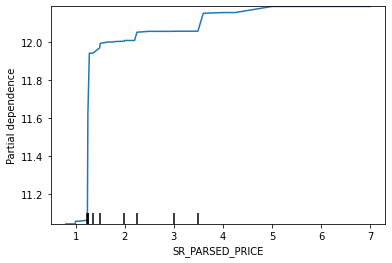

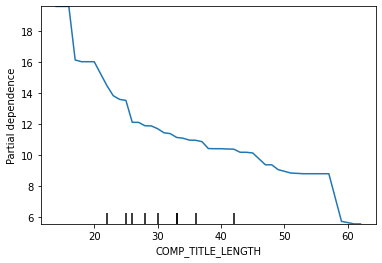

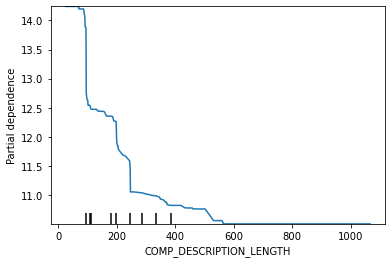

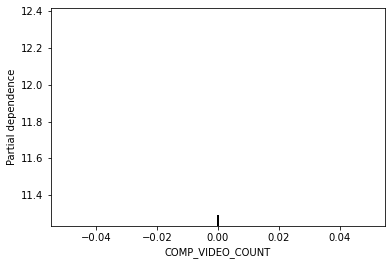

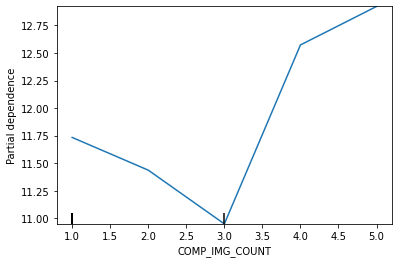

...

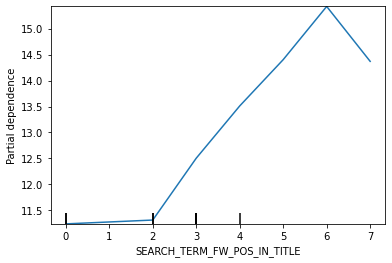

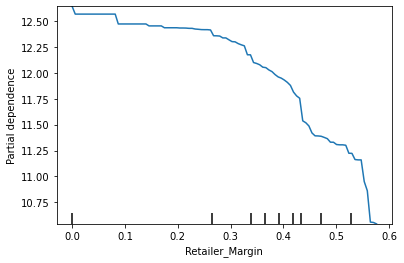

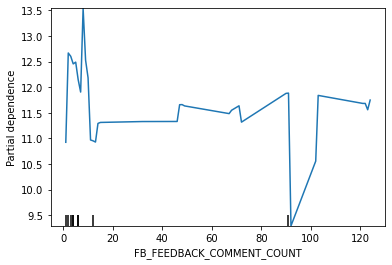

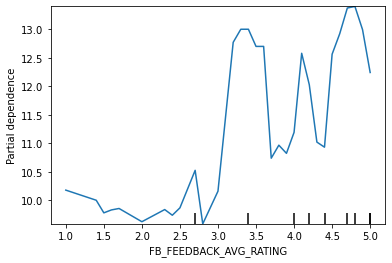

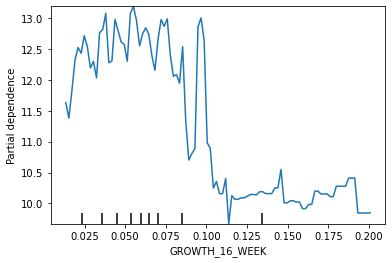

In [78]:
# for i in features:
#     plot_partial_dependence(gbm, model_x_train, [i], grid_resolution=100)
#     plt.show()

In [81]:
model_x_train

,SR_PARSED_PRICE,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_HAS_RICH_CONTENT,RETAIL_SALES_VALUE,SEARCH_TERM_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_COUNT_IN_DESC,SEARCH_TERM_FW_POS_IN_TITLE,Retailer_Margin,HOLIDAY_FLAG,FB_FEEDBACK_COMMENT_COUNT,FB_FEEDBACK_AVG_RATING,AV_OOS_AVAILABLE,AV_OOS_OOS,GROWTH_16_WEEK
22676,5.000,38,325,0,4,0,1230.000,0,1,0,2,0,0.563,0,123.000,4.600,1,0,0.018
13688,3.000,26,109,0,3,0,3318.000,0,0,0,0,2,-7.447,1,1.000,5.000,1,0,0.044
10664,1.500,22,197,0,1,0,28497.200,0,0,0,0,3,0.433,1,6.000,4.200,1,0,0.061
5859,0.990,33,531,0,1,0,7070.250,1,1,1,2,3,0.000,1,4.000,3.000,1,0,0.066
21276,1.350,42,94,0,1,0,10980.000,0,0,0,0,5,0.428,0,68.000,4.400,1,0,0.052
5683,1.000,33,307,0,1,0,4001.050,0,0,0,0,3,0.000,0,1.000,1.000,1,0,0.186
9427,1.500,24,368,0,1,0,13945.900,0,0,0,0,4,0.322,1,6.000,4.800,1,0,0.038
23299,1.990,33,244,0,1,0,7241.020,0,0,0,0,4,0.412,0,3.000,2.700,1,0,0.056
11206,1.250,22,199,0,1,0,23120.500,0,1,0,1,0,0.421,0,4.000,4.000,1,0,0.062
18250,3.500,32,92,0,1,0,11578.500,1,0,1,0,2,0.431,0,3.000,5.000,1,0,0.083


In [0]:
model=model_x_train.append(model_x_test)
print(df_model.columns)

Index(['GTIN', 'GATHERED_DATE', 'SR_SEARCH_TERM', 'SR_PAID_SEARCH', 'SR_RANK',
       'BRAND', 'SR_PARSED_PRICE', 'FB_FEEDBACK_AVG_RATING',
       'COMP_HAS_RICH_CONTENT', 'COMP_VIDEO_COUNT', 'COMP_IMG_COUNT',
       'COMP_TITLE_LENGTH', 'COMP_DESCRIPTION_LENGTH',
       'FB_FEEDBACK_COMMENT_COUNT', 'SR_PROMOTION_TYPE', 'Clubcard_flag',
       'COMP_RETAILER_PRODUCT_NAME', 'COMP_DESCRIPTION', 'SEARCH_TERM_IN_NAME',
       'SEARCH_TERM_COUNT_IN_NAME', 'SEARCH_TERM_IN_DESC',
       'SEARCH_TERM_COUNT_IN_DESC', 'Retailer_Margin', 'RETAIL_SALES_VALUE',
       'RETAIL_SALES_UNIT', 'LAST_1_WEEK_SALES', 'LAST_8_WEEK_SALES',
       'HOLIDAY_FLAG', 'SEARCH_TERM_FW_POS_IN_TITLE', 'GROWTH_4_WEEK',
       'GROWTH_8_WEEK', 'GROWTH_16_WEEK', 'AV_OOS_AVAILABLE', 'AV_OOS_OOS',
       'PACK_TYPE_Boxed Chocolate', 'PACK_TYPE_Multipack',
       'PACK_TYPE_Packaged', 'PACK_TYPE_Premium Selection', 'PACK_TYPE_Single',
       'PR_SUBSCRIPTION_NOT AVAILABLE'],
      dtype='object')


In [0]:
categorical_columns=cat_cols
INCLUDE_COLS=independent_model_cols

In [0]:
df_model1=df_model
df_model1["PREDICTION"]=gbm.predict(df_model1[INCLUDE_COLS])
df_model1["PREDICTION"]=np.where(df_model1['PREDICTION']<0,1,df_model1['PREDICTION'])

In [0]:
# error_df=pd.DataFrame({'Model_Name':[project_code],'MAE_Train':[mae_train],'MAE_Test':[mae_test],'MAPE_Train':[mape_train],'MAPE_Test':[mape_test],'W-MAPE_Train':[wmape_train],'W-MAPE_Test':[wmape_test],'RSq_Train':[r2_train],'RSq_Test':[r2_test],'params':[params],'monotone':[monotone_cols],'positive_correlation':[positive_corelation],'negative_correlation':[negative_corelation]})
f_imp=pd.DataFrame({'Feature':model_x_train.columns,'Importance':gbm.feature_importances_})
f_imp["Norm"]=100*f_imp["Importance"]/f_imp["Importance"].sum()
f_imp_master=pd.concat([f_imp_master,f_imp])
predictions_df_master=pd.concat([predictions_df_master,df_predictions,df_predictions,df_predictions_train])

In [0]:
predictions_df_master.head()

,Actual,Predicted,Error,Train_Test
23063,2,5.549,3.549,Test
12293,19,20.438,1.438,Test
17084,10,9.389,-0.611,Test
25142,1,1.333,0.333,Test
8504,21,21.865,0.865,Test


In [0]:
f_imp.display()

Feature,Importance,Norm
SR_PARSED_PRICE,79581.64491939545,0.8847104668916683
COMP_TITLE_LENGTH,548002.8683047295,6.092156978746873
COMP_DESCRIPTION_LENGTH,486082.31362247467,5.403785145033024
COMP_VIDEO_COUNT,0.0,0.0
COMP_IMG_COUNT,327674.3696471453,3.6427614037455767
COMP_HAS_RICH_CONTENT,0.0,0.0
RETAIL_SALES_VALUE,1581051.8718580008,17.576579890352736
SEARCH_TERM_IN_NAME,324775.5302836895,3.6105349584479893
SEARCH_TERM_IN_DESC,305427.64389562607,3.3954441844750733
SEARCH_TERM_COUNT_IN_NAME,42396.87657690048,0.47132678030328656


In [0]:
predictions_df_master.display()

Actual,Predicted,Error,Train_Test
2,5.5485263210453635,3.5485263210453635,Test
19,20.438215342206348,1.4382153422063482,Test
10,9.389019846702185,-0.610980153297815,Test
1,1.3325118658813107,0.33251186588131065,Test
21,21.8653715980967,0.8653715980967007,Test
26,17.453065339973584,-8.546934660026416,Test
5,7.227622110184513,2.2276221101845133,Test
19,7.66897982748744,-11.33102017251256,Test
17,18.023050384022994,1.0230503840229943,Test
2,2.322871280633128,0.322871280633128,Test


In [0]:
temp=model_x_test.join(model_y_test)
temp=temp.reset_index(drop=True)

In [0]:
!pip install shap

Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.
Note: you may need to restart the kernel using dbutils.library.restartPython() to use updated packages.


In [0]:
# !pip install numba==0.53


In [0]:
temp.columns

Index(['SR_PARSED_PRICE', 'COMP_TITLE_LENGTH', 'COMP_DESCRIPTION_LENGTH',
       'COMP_VIDEO_COUNT', 'COMP_IMG_COUNT', 'COMP_HAS_RICH_CONTENT',
       'RETAIL_SALES_VALUE', 'SEARCH_TERM_IN_NAME', 'SEARCH_TERM_IN_DESC',
       'SEARCH_TERM_COUNT_IN_NAME', 'SEARCH_TERM_COUNT_IN_DESC',
       'SEARCH_TERM_FW_POS_IN_TITLE', 'Retailer_Margin', 'HOLIDAY_FLAG',
       'FB_FEEDBACK_COMMENT_COUNT', 'FB_FEEDBACK_AVG_RATING',
       'AV_OOS_AVAILABLE', 'AV_OOS_OOS', 'GROWTH_16_WEEK', 'SR_RANK'],
      dtype='object')

In [0]:
temp.columns

Index(['SR_PARSED_PRICE', 'COMP_TITLE_LENGTH', 'COMP_DESCRIPTION_LENGTH',
       'COMP_VIDEO_COUNT', 'COMP_IMG_COUNT', 'COMP_HAS_RICH_CONTENT',
       'RETAIL_SALES_VALUE', 'SEARCH_TERM_IN_NAME', 'SEARCH_TERM_IN_DESC',
       'SEARCH_TERM_COUNT_IN_NAME', 'SEARCH_TERM_COUNT_IN_DESC',
       'SEARCH_TERM_FW_POS_IN_TITLE', 'Retailer_Margin', 'HOLIDAY_FLAG',
       'FB_FEEDBACK_COMMENT_COUNT', 'FB_FEEDBACK_AVG_RATING',
       'AV_OOS_AVAILABLE', 'AV_OOS_OOS', 'GROWTH_16_WEEK', 'SR_RANK'],
      dtype='object')

In [0]:
# for i in features:
#   plot_partial_dependence(gbm, model_x_train, [i], grid_resolution=100)
#   plt.show()

In [0]:
# temp=temp[temp['SR_RANK']>24]
# temp=temp.reset_index(drop=True)

In [0]:
temp[temp['SR_RANK']>24].head()

,SR_PARSED_PRICE,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_HAS_RICH_CONTENT,RETAIL_SALES_VALUE,SEARCH_TERM_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_COUNT_IN_DESC,SEARCH_TERM_FW_POS_IN_TITLE,Retailer_Margin,HOLIDAY_FLAG,FB_FEEDBACK_COMMENT_COUNT,FB_FEEDBACK_AVG_RATING,AV_OOS_AVAILABLE,AV_OOS_OOS,GROWTH_16_WEEK,SR_RANK
5,2.250,47,124,0,1,0,11722.500,0,0,0,0,3,0.448,1,4.000,3.200,1,0,0.055,26
14,1.250,23,92,0,1,0,2193.000,0,0,0,0,3,0.410,0,3.000,3.700,1,0,0.061,25
21,1.500,33,571,0,1,0,3105.340,1,0,1,0,3,0.380,1,6.000,5.000,1,0,0.046,25
23,1.350,27,186,0,1,0,3252.150,0,0,0,0,2,0.405,0,4.000,4.000,1,0,0.031,26
36,1.250,45,68,0,4,0,661.250,0,0,0,0,4,0.366,1,1.000,5.000,1,0,0.086,25


In [0]:
# temp.to_csv('/dbfs/mnt/adls-gen2/SmartDataLake/Temp/Sahil/before_stimu.csv',index=False)

In [0]:
temp=temp.head(10)

In [0]:
# import shap
# import numpy as np
# import pandas as pd
# import lightgbm as lgb

# final_df=pd.DataFrame()

# # Select an initial instance (row) from the dataframe
# for i in temp.index:
#     instance = temp.iloc[[i]]

#     # Calculate SHAP values for the initial instance (outside the loop)
#     explainer = shap.Explainer(gbm)
#     shap_values = explainer.shap_values(instance.drop(['SR_RANK'], axis=1))

#     # Define the continuous variables and their allowed ranges
#     continuous_variables = {

#         'COMP_TITLE_LENGTH': (20, 60),
#         'COMP_DESCRIPTION_LENGTH': (90, 550),
#         'COMP_VIDEO_COUNT': (0.0, 1.0),
#         'COMP_IMG_COUNT' : (1,5),
#         'SEARCH_TERM_COUNT_IN_NAME' : (0,1),
#         'SEARCH_TERM_COUNT_IN_DESC' : (0,10) ,
#         'SEARCH_TERM_FW_POS_IN_TITLE' : (0,7) ,
#         'Retailer_Margin' : (1,3),
#         'FB_FEEDBACK_AVG_RATING' : (2,5),
#         'FB_FEEDBACK_COMMENT_COUNT': (1,70),
#           'RETAIL_SALES_VALUE' : (1300,30000),
#           'RETAIL_SALES_UNIT':(500,20000)
#         # Add other continuous variables here
#     }

#     # Define possible values for categorical features
#     categorical_features = {
#             'COMP_HAS_RICH_CONTENT':[0,1],
#         'SEARCH_TERM_IN_NAME': [0,1],
#         'SEARCH_TERM_IN_DESC': [0,1], 
#         'HOLIDAY_FLAG':[0,1], 
#         'AV_OOS_AVAILABLE':[0,1], 
#         'AV_OOS_OOS':[0,1]
#         # Add other categorical features and their possible values here
#     }


#     # Specify the non-categorical columns explicitly
#     non_categorical_columns = [col for col in instance.columns if col not in continuous_variables.keys() and col not in categorical_features.keys() and col != 'SR_RANK']

#     # Define the learning rate for gradient descent
#     learning_rate = 4

#     # Define the maximum number of iterations for gradient descent
#     max_iterations = 100

#     # Define the tolerance for improvement in SR_RANK
#     tolerance = 0.1

#     # Initial SR_RANK value
#     initial_sr_rank = instance['SR_RANK'].values[0]

#     # Start the optimization loop
#     for iteration in range(max_iterations):
#         # Calculate the feature importances based on SHAP values for one-hot encoded columns
#         abs_shap_values = np.abs(shap_values)
#         sum_abs_shap_values = np.sum(abs_shap_values, axis=1)
#         rel_importance = np.sum(abs_shap_values, axis=0) / np.sum(sum_abs_shap_values)
        
#         # Copy the instance for modification
#         new_instance = instance.copy()
        
#         # Update continuous variables within their allowed ranges
#         for var, (min_val, max_val) in continuous_variables.items():
#             change = learning_rate * shap_values[0][list(instance.columns).index(var)]
#             new_value = new_instance[var] + change
            
#             # Ensure the new value is within the specified range using np.clip
#             new_instance[var] = np.clip(new_value, min_val, max_val)
        
#         # Update categorical features
#         for cat_var, cat_values in categorical_features.items():
#             change = learning_rate * shap_values[0][list(instance.columns).index(cat_var)]
#             current_value = new_instance[cat_var]
            
#             # Convert categorical feature values to lists
#             cat_values_list = list(cat_values)
            
#             # Calculate the index of the new value based on SHAP importance
#             current_index = cat_values_list.index(current_value.item())
#             new_index = max(0, min(len(cat_values_list) - 1, current_index + int(round(change))))
            
#             # Set the new value based on the calculated index
#             new_instance[cat_var] = cat_values_list[new_index]

#         # Predict SR_RANK with the updated instance
#         new_sr_rank = gbm.predict(new_instance.drop(['SR_RANK'], axis=1))[0]

#         # Check if the SR_RANK has improved within the tolerance
#         if abs(new_sr_rank - initial_sr_rank) < tolerance:
#             break

#         # Update the instance for the next iteration
#         if initial_sr_rank < new_sr_rank:
#           new_sr_rank=initial_sr_rank
        
#         new_instance['SR_RANK'] = new_sr_rank

#     # The 'instance' variable now contains the optimized values for all features that result in an improved SR_RANK
#     final_df=final_df.append(new_instance)
#     # print("Best rank possible:")
#     # print(new_sr_rank)


In [0]:
import shap
import numpy as np
import pandas as pd
import lightgbm as lgb

# Load your model and DataFrame here
# gbm = load_model()
# temp = load_dataframe()

# Define the continuous variables and their allowed ranges
continuous_variables = {
    'COMP_TITLE_LENGTH': (20, 60),
    'COMP_DESCRIPTION_LENGTH': (90, 550),
    'COMP_VIDEO_COUNT': (0.0, 1.0),
    'COMP_IMG_COUNT': (1, 5),
    'SEARCH_TERM_COUNT_IN_NAME': (0, 1),
    'SEARCH_TERM_COUNT_IN_DESC': (0, 10),
    'SEARCH_TERM_FW_POS_IN_TITLE': (0, 7),
    'Retailer_Margin': (1, 3),
    'FB_FEEDBACK_AVG_RATING': (2, 4),
    'FB_FEEDBACK_COMMENT_COUNT': (1, 70)
    # Add other continuous variables here
}

# Define possible values for categorical features
categorical_features = {
    'COMP_HAS_RICH_CONTENT': [0, 1],
    'SEARCH_TERM_IN_NAME': [0, 1],
    'SEARCH_TERM_IN_DESC': [0, 1],
    'HOLIDAY_FLAG': [0, 1],
    'AV_OOS_AVAILABLE': [0, 1],
    'AV_OOS_OOS': [0, 1]
    # Add other categorical features and their possible values here
}

# Specify the non-categorical columns explicitly
non_categorical_columns = [col for col in temp.columns if
                           col not in continuous_variables.keys() and col not in categorical_features.keys() and
                           col != 'SR_RANK']

# Define the learning rate for gradient descent
learning_rate = 4

# Define the maximum number of iterations for gradient descent
max_iterations = 100

# Define the tolerance for improvement in SR_RANK
tolerance = 0.1

# Initialize a new DataFrame to store optimized results
optimized_data = pd.DataFrame(columns=temp.columns)

# Start the optimization loop for each row
for idx, row in temp.iterrows():
    # Select an initial instance (row) from the DataFrame
    instance = pd.DataFrame(row).transpose()
    
    # Calculate SHAP values for the initial instance
    explainer = shap.Explainer(gbm)
    shap_values = explainer.shap_values(instance.drop(['SR_RANK'], axis=1))
    
    # Initial SR_RANK value
    initial_sr_rank = instance['SR_RANK'].values[0]
    
    # Start the optimization loop for this instance
    for iteration in range(max_iterations):
        # Calculate the feature importances based on SHAP values for one-hot encoded columns
        abs_shap_values = np.abs(shap_values)
        sum_abs_shap_values = np.sum(abs_shap_values, axis=1)
        rel_importance = np.sum(abs_shap_values, axis=0) / np.sum(sum_abs_shap_values)
        
        # Copy the instance for modification
        new_instance = instance.copy()
        
        # Update continuous variables within their allowed ranges
        for var, (min_val, max_val) in continuous_variables.items():
            change = learning_rate * shap_values[0][list(instance.columns).index(var)]
            new_value = new_instance[var] + change
            
            # Ensure the new value is within the specified range using np.clip
            new_value = np.clip(new_value, min_val, max_val)
            new_instance[var] = new_value
        
        # Update categorical features
        for cat_var, cat_values in categorical_features.items():
            change = learning_rate * shap_values[0][list(instance.columns).index(cat_var)]
            current_value = new_instance[cat_var]
            
            # Convert categorical feature values to lists
            cat_values_list = list(cat_values)
            
            # Calculate the index of the new value based on SHAP importance
            current_index = cat_values_list.index(current_value.item())
            new_index = max(0, min(len(cat_values_list) - 1, current_index + int(round(change))))
            
            # Set the new value based on the calculated index
            new_instance[cat_var] = cat_values_list[new_index]
    
        # Predict SR_RANK with the updated instance
        new_sr_rank = gbm.predict(new_instance.drop(['SR_RANK'], axis=1))[0]
    
        # Check if the SR_RANK has improved within the tolerance
        if abs(new_sr_rank - initial_sr_rank) < tolerance:
            break
    
        # Update the instance for the next iteration
        if (initial_sr_rank < new_sr_rank) | (new_sr_rank<0):
            new_sr_rank = initial_sr_rank
        
        new_instance['SR_RANK'] = new_sr_rank
    
    # Append the optimized instance to the new DataFrame
    optimized_data = optimized_data.append(new_instance, ignore_index=True)

# The 'optimized_data' DataFrame now contains the optimized values for all rows

In [0]:
optimized_data.head()

,SR_PARSED_PRICE,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_HAS_RICH_CONTENT,RETAIL_SALES_VALUE,SEARCH_TERM_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_COUNT_IN_DESC,SEARCH_TERM_FW_POS_IN_TITLE,Retailer_Margin,HOLIDAY_FLAG,FB_FEEDBACK_COMMENT_COUNT,FB_FEEDBACK_AVG_RATING,AV_OOS_AVAILABLE,AV_OOS_OOS,GROWTH_16_WEEK,SR_RANK
0,1.990,28.823,243.812,0.000,1.721,0,7732.070,0,1,0.821,0.022,0.000,1.000,0,5.756,2.000,1,0,0.070,2.000
1,0.990,28.462,184.276,0.000,1.931,0,1148.400,1,1,0.000,1.976,0.000,3.000,0,9.908,2.000,1,0,0.055,6.165
2,3.500,25.615,550.000,0.000,1.000,0,24469.500,0,0,1.000,0.018,4.112,1.000,1,7.271,4.000,1,0,0.123,9.185
3,1.000,30.603,338.551,0.000,1.000,0,2342.000,0,0,0.874,0.020,0.000,2.367,0,1.000,2.000,1,0,0.123,0.591
4,1.250,40.687,95.646,0.000,5.000,0,887.500,1,0,0.969,0.041,3.808,1.000,0,1.000,4.000,1,0,0.073,12.542


In [0]:
temp.head()

,SR_PARSED_PRICE,COMP_TITLE_LENGTH,COMP_DESCRIPTION_LENGTH,COMP_VIDEO_COUNT,COMP_IMG_COUNT,COMP_HAS_RICH_CONTENT,RETAIL_SALES_VALUE,SEARCH_TERM_IN_NAME,SEARCH_TERM_IN_DESC,SEARCH_TERM_COUNT_IN_NAME,SEARCH_TERM_COUNT_IN_DESC,SEARCH_TERM_FW_POS_IN_TITLE,Retailer_Margin,HOLIDAY_FLAG,FB_FEEDBACK_COMMENT_COUNT,FB_FEEDBACK_AVG_RATING,AV_OOS_AVAILABLE,AV_OOS_OOS,GROWTH_16_WEEK,SR_RANK
0,1.990,33,244,0,1,0,7732.070,0,0,0,0,0,0.422,0,3.000,2.700,1,0,0.070,2
1,0.990,26,182,0,1,0,1148.400,1,1,1,2,2,-1.327,0,6.000,3.800,1,0,0.055,19
2,3.500,26,565,0,1,0,24469.500,0,0,0,0,3,0.573,1,5.000,4.200,1,0,0.123,10
3,1.000,35,342,0,1,0,2342.000,0,0,0,0,0,0.000,0,1.000,1.000,1,0,0.123,1
4,1.250,44,87,0,4,0,887.500,1,0,0,0,3,0.445,0,1.000,5.000,1,0,0.073,21


In [0]:
ff

---------------------------------------------------------------------------
NameError                                 Traceback (most recent call last)
File <command-3923730657869526>, line 1
----> 1 ff

NameError: name 'ff' is not defined

In [0]:
## for single value checks

import shap
import numpy as np
import pandas as pd
import lightgbm as lgb


# Select an initial instance (row) from the dataframe

instance = temp.iloc[[5]]

# Calculate SHAP values for the initial instance (outside the loop)
explainer = shap.Explainer(gbm)
shap_values = explainer.shap_values(instance.drop(['SR_RANK'], axis=1))

# Define the continuous variables and their allowed ranges
continuous_variables = {

    'COMP_TITLE_LENGTH': (20, 60),
    'COMP_DESCRIPTION_LENGTH': (90, 550),
    'COMP_VIDEO_COUNT': (0.0, 1.0),
    'COMP_IMG_COUNT' : (1,5),
    'SEARCH_TERM_COUNT_IN_NAME' : (0,1),
    'SEARCH_TERM_COUNT_IN_DESC' : (0,10) ,
    'SEARCH_TERM_FW_POS_IN_TITLE' : (0,7) ,
    'Retailer_Margin' : (1,3),
    'FB_FEEDBACK_AVG_RATING' : (2,4),
    'FB_FEEDBACK_COMMENT_COUNT': (1,70),
    'RETAIL_SALES_VALUE' : (1300,30000),
    'RETAIL_SALES_UNIT':(500,20000)
    # Add other continuous variables here
}

# Define possible values for categorical features
categorical_features = {
        'COMP_HAS_RICH_CONTENT':[0,1],
    'SEARCH_TERM_IN_NAME': [0,1],
    'SEARCH_TERM_IN_DESC': [0,1], 
    'HOLIDAY_FLAG':[0,1], 
    'AV_OOS_AVAILABLE':[0,1], 
    'AV_OOS_OOS':[0,1]
    # Add other categorical features and their possible values here
}


# Specify the non-categorical columns explicitly
non_categorical_columns = [col for col in instance.columns if col not in continuous_variables.keys() and col not in categorical_features.keys() and col != 'SR_RANK']

# Define the learning rate for gradient descent
learning_rate = 4

# Define the maximum number of iterations for gradient descent
max_iterations = 100

# Define the tolerance for improvement in SR_RANK
tolerance = 0.1

# Initial SR_RANK value
initial_sr_rank = instance['SR_RANK'].values[0]

# Start the optimization loop
for iteration in range(max_iterations):
    # Calculate the feature importances based on SHAP values for one-hot encoded columns
    abs_shap_values = np.abs(shap_values)
    sum_abs_shap_values = np.sum(abs_shap_values, axis=1)
    rel_importance = np.sum(abs_shap_values, axis=0) / np.sum(sum_abs_shap_values)
    
    # Copy the instance for modification
    new_instance = instance.copy()
    
    # Update continuous variables within their allowed ranges
    for var, (min_val, max_val) in continuous_variables.items():
        change = learning_rate * shap_values[0][list(instance.columns).index(var)]
        new_value = new_instance[var] + change
        
        # Ensure the new value is within the specified range using np.clip
        new_instance[var] = np.clip(new_value, min_val, max_val)
    
    # Update categorical features
    for cat_var, cat_values in categorical_features.items():
        change = learning_rate * shap_values[0][list(instance.columns).index(cat_var)]
        current_value = new_instance[cat_var]
        
        # Convert categorical feature values to lists
        cat_values_list = list(cat_values)
        
        # Calculate the index of the new value based on SHAP importance
        current_index = cat_values_list.index(current_value.item())
        new_index = max(0, min(len(cat_values_list) - 1, current_index + int(round(change))))
        
        # Set the new value based on the calculated index
        new_instance[cat_var] = cat_values_list[new_index]

    # Predict SR_RANK with the updated instance
    new_sr_rank = gbm.predict(new_instance.drop(['SR_RANK'], axis=1))[0]

    # Check if the SR_RANK has improved within the tolerance
    if abs(new_sr_rank - initial_sr_rank) < tolerance:
        break

    # Update the instance for the next iteration
    if initial_sr_rank < new_sr_rank:
      new_sr_rank=initial_sr_rank
    
    new_instance['SR_RANK'] = new_sr_rank

# The 'instance' variable now contains the optimized values for all features that result in an improved SR_RANK
print("Best rank possible:")
print(new_sr_rank)


In [0]:
instance

In [0]:
new_instance

In [0]:
ff

In [0]:


# # Define the search space for categorical variables
# categorical_space = {
    
#     'COMP_HAS_RICH_CONTENT':[0,1],
#     'SEARCH_TERM_IN_NAME': [0,1],
#     'SEARCH_TERM_IN_DESC': [0,1], 
#     'HOLIDAY_FLAG':[0,1], 
#     'AV_OOS_AVAILABLE':[0,1], 
#     'AV_OOS_OOS':[0,11]
#  }

# # Define the search space for continuous variables
# continuous_space = {
#     'COMP_TITLE_LENGTH': (14, 62),
#     'COMP_DESCRIPTION_LENGTH': (26, 1066),
#     'COMP_VIDEO_COUNT': (0.0, 100.0),
#     'COMP_IMG_COUNT' : (),
#     'SEARCH_TERM_COUNT_IN_NAME' : (),
#      'SEARCH_TERM_COUNT_IN_DESC' : () ,
#      'SEARCH_TERM_FW_POS_IN_TITLE' : () ,
#      'Retailer_Margin' : (),


# }

# # Define the search space for non-control variables
# non_control_space = {
#     'SR_PARSED_PRICE': (0.8, 7),
#     'RETAIL_SALES_VALUE': (0, 1000),
#     'RETAIL_SALES_UNIT' : () ,
#     'LAST_1_WEEK_SALES' : (),
#     'LAST_2_WEEK_SALES' : (),
#     'LAST_4_WEEK_SALES' : (),
#     'LAST_8_WEEK_SALES' : (),
#     'LAST_16_WEEK_SALES' : (),
#     'FB_FEEDBACK_COMMENT_COUNT' : () ,
    
# }



In [0]:
import shap
import numpy as np
import pandas as pd
import lightgbm as lgb

import shap
# Select an initial instance (row) from the dataframe
instance = temp.iloc[[106]]
ins= temp.iloc[106]


# Set the initial value of the target feature to the current value
target_feature_initial_value = instance['SR_RANK'].values[0]

# Define the desired target value for the target feature
desired_target_value = 1

# Set the tolerance for the difference between the predicted value and the desired target value
tolerance = 1e-6

# Define the learning rate for gradient descent
learning_rate = 10

# Define the maximum number of iterations for gradient descent
max_iterations = 1000



# Calculate SHAP values for the initial instance (outside the loop)
explainer = shap.Explainer(gbm)
shap_values = explainer.shap_values(instance.drop(['SR_RANK'], axis=1))

# Specify the one-hot encoded columns explicitly
one_hot_columns = ['AV_OOS_AVAILABLE', 'AV_OOS_OOS', 'PACK_TYPE_Boxed Chocolate',
       'PACK_TYPE_Multipack', 'PACK_TYPE_Packaged',
       'PACK_TYPE_Premium Selection', 'PACK_TYPE_Single','PR_SUBSCRIPTION_NOT AVAILABLE']

# Loop until the predicted value of the target feature is within the tolerance of the desired target value
for i in range(max_iterations):
    # Calculate the feature weightages for the current instance based on SHAP values
    abs_shap_values = np.abs(shap_values)
    sum_abs_shap_values = np.sum(abs_shap_values, axis=1)
    rel_importance = np.sum(abs_shap_values, axis=0) / np.sum(sum_abs_shap_values)

    # Create a new instance with the same column structure as the original dataframe
    new_instance = instance.copy()
    new_instance['SR_RANK']=desired_target_value

    for col in one_hot_columns:
        new_instance[col] += round(learning_rate * (rel_importance[one_hot_columns.index(col)]))
    


    # Recalculate the predicted value of the target feature
    predicted_target_value = gbm.predict(new_instance.drop(['SR_RANK'], axis=1))

    # Calculate the desired change in the target feature value
    desired_change = (target_feature_initial_value - desired_target_value)
    # print(desired_change)

    # Apply gradient descent to update other columns
    non_categorical_columns = [col for col in instance.columns if col not in one_hot_columns + ['SR_RANK']]
    for col in non_categorical_columns:
        new_instance[col] += round(learning_rate * (rel_importance[non_categorical_columns.index(col)] * desired_change))

    # Check if the predicted value is within the tolerance of the desired target value
    if abs(predicted_target_value - desired_target_value) < tolerance:
        break

# The 'new_instance' variable now contains the values for all features that produce the desired target value
print("Final Instance:")
print(new_instance)


In [0]:
instance

In [0]:
new_instance

In [0]:
temp.head(1)

In [0]:
ff

In [0]:
import lightgbm as lgb
import pandas as pd
import numpy as np

# Load your dataset and model here
# X, y = load_data()  # Load your dataset
# gbm = load_model()  # Load your trained LightGBM model

# Input feature names
feature_names = model_x_train.columns

# Function to predict with the current feature values
def predict_with_features(feature_values):
    # Create a DataFrame with the provided feature values
    input_data = pd.DataFrame([feature_values], columns=feature_names)
    
    # Predict with the model
    prediction = gbm.predict(input_data)[0]
    return prediction

# Initialize feature values
current_feature_values = model_x_train.iloc[0]

# Create a DataFrame to store the results
results_df = pd.DataFrame(columns=['Feature', 'Original_Prediction', 'Changed_Prediction', 'Difference'])

# Loop through each feature and observe its impact
for i, feature_name in enumerate(feature_names):
    # Copy the current feature values to avoid modifying the original
    modified_feature_values = current_feature_values.copy()
    
    # Change the feature value for this iteration (e.g., increment by 1)
    modified_feature_values[i] *= 1.1
    
    # Predict with the original feature values
    original_prediction = predict_with_features(current_feature_values)
    
    # Predict with the changed feature values
    changed_prediction = predict_with_features(modified_feature_values)
    
    # Calculate the difference
    difference = changed_prediction - original_prediction
    
    # Store the results in the DataFrame
    results_df = results_df.append({'Feature': feature_name, 
                                    'Original_Prediction': original_prediction, 
                                    'Changed_Prediction': changed_prediction, 
                                    'Difference': difference}, 
                                   ignore_index=True)


In [0]:
results_df

In [0]:
ff

Simulations

In [0]:
config= {
    # "PREDICTIONS_FILEPATH": "/dbfs/mnt/PROCESS/EU_MW_DCOM/MODEL_OUTPUT/RETAILER_SEARCH_ALGORITHM/ITERATIONS/NLD/MARS/GBM_22032023_1217/GBM_model_python_1679465843553_9_Predictions.csv",
    # "MODEL_FILEPATH": "/dbfs/mnt/PROCESS/EU_MW_DCOM/MODEL_OUTPUT/RETAILER_SEARCH_ALGORITHM/ITERATIONS/NLD/MARS/GBM_22032023_1217/GBM_model_python_1679465843553_9",
    # "OUTPUT_FILENAME": "Simulations.csv",
    "COLUMNS_TO_MERGE_ON": [
      "GATHERED_DATE",
      "GTIN",
      "SR_SEARCH_TERM",
      # "COMP_RETAILER_PRODUCT_NAME",
      # "COMP_DESCRIPTION",
      #"SR_PAID_SEARCH"
    ],
    "COLUMNS_TO_DROP_MODEL": [
      "GTIN",
      "SR_SEARCH_TERM",
      "GATHERED_DATE",
      "COMP_RETAILER_PRODUCT_NAME",
      "COMP_DESCRIPTION"
    ],
    "SIMULATIONS_LOGIC": {
      "ABSOLUTE": {
        "AV_OOS": [
          "AVAILABLE"
        ],
        "NO_PROMOTION":[0],
        "Discount_Depth_tmp":[0],
      #  "PRICE_CUT_PROMOTION":[0],
      #  "BUNDLE_PROMOTION":[0],
      #  "COUPON_PROMOTION,PRICE_CUT_PROMOTION,BUNDLE_PROMOTION":[0],
        # "SR_PROMOTION_TYPE": [
        #   "NO_PROMOTION"
        # ],
        # "SR_PAID_SEARCH": [
        #   "Organic"
        # ],
        "COMP_SCORE_IMAGE": [
          0
        ],
        "EASTER": [
          0
        ],
        "HALLOWEEN": [
          0
        ],
        "VALENTINE": [
          0
        ],
        "CHRISTMAS": [
          0
        ],
        "Last 30 days paid_count":[0],
        'Last 30 days promotion_count':[0]
      },
      "PERCENT_PROPORTION": {
        "COMP_DESCRIPTION_LENGTH": [
          -10,
          10
        ],
        "SR_PARSED_PRICE": [
          -10,
          10
        ],
        "COMP_TITLE_LENGTH": [
          -10,
          10
        ],
        "LAST_1_WEEK_SALES_new": [
          -10,
          10
        ],
        "LAST_8_WEEK_SALES_new": [
          -10,
          10
        ],
        "LAST_16_WEEK_SALES_new": [
          -10,
          10
        ],
        "Retailer_Margin": [
          -10,
          10
        ],
        "LAST_1_WEEK_SALES_new,LAST_8_WEEK_SALES_new,LAST_16_WEEK_SALES_new": [
          -10,
          10
        ]
      },
      "ABSOLUTE_PROPORTION": {
        "Last 30 days paid_count":{
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 30
          }
        },
        "Days_since_last_paid": {
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 30
          }
        },
        "Days_since_last_promotion":{
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 30
          }
        },
        # "Last 30 days_continous": {
        #   "VALUES": [
        #     -10,
        #     10
        #   ],
        #   "LIMIT": {
        #     "LOWER": 0,
        #     "UPPER": 30
        #   }
        # },

        "SEARCH_TERM_IN_TITLE_FW_SCORE": {
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 100
          }
        },
        "SEARCH_TERM_IN_DESC_FW_SCORE": {
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 100
          }
        },
        "Retailer_Margin": {
          "VALUES": [
            -0.01,
            0.01,
            -0.02,
            0.02
          ]
        },
        # "SEARCH_TERM_WORD_COUNT": {
        #   "VALUES": [
        #     -1,
        #     1,
        #     -2,
        #     2
        #   ],
        #   "LIMIT": {
        #     "LOWER": 1
        #   }
        # },
        "SEARCH_TERM_COUNT_IN_NAME": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_RETAILER_PRODUCT_NAME"
          },
          "EXCLUDE": [
            0
          ]
        },
        "SEARCH_TERM_COUNT_IN_DESC": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_DESCRIPTION"
          },
          "EXCLUDE": [
            0
          ]
        },
        "SEARCH_TERM_FW_POS_IN_TITLE": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_RETAILER_PRODUCT_NAME"
          },
          "EXCLUDE": [
            0
          ]
        }
      },
    }}
  


In [0]:
def decode_simulations_logic(logic: dict) -> dict:
    """
    Converts string keys to tuple.

    Parameters
    ----------
    logic : dict
      Dictionary with string keys.

    Returns
    -------
    decoded_logic : pandas.DataFrame
      Dictionary with tuple keys.
    """
    decoded_logic = {
        tuple(k.split(",")) if "," in k else tuple([k]): v for k, v in logic.items()
    }
    return decoded_logic


def simulate_absolute(
    df_input: pd.DataFrame,
    columns: list,
    values: list,
    columns_to_merge_on: list,
    columns_to_drop_model: list,
    categorical_columns: list,
    model,
) -> pd.DataFrame:

    """
    Simulates columns by replacing with input absolute values.

    Parameters
    ----------
    df_input : pandas.DataFrame
      DataFrame with input columns.
    columns : list
      List of columns to simulate on.
    values : list
      List of values to simulate on.
    columns_to_merge_on : list
      List of columns to perform join on output dataframe.
    columns_to_drop_model : list
      List of columns to drop before model prediction.
    model : h2o.estimators.gbm.H2OGradientBoostingEstimator
      Trained model.

    Returns
    -------
    df_output : pandas.DataFrame
      Dataframe with updated columns and predictions.
    """

    df_output = df_input[columns_to_merge_on].copy()
    for value in values:
        df_temp = df_input.copy()
        for column in columns:
            df_temp[column] = value
        final_column_name = "_".join(columns) + "_" + str(value)
        df_output[final_column_name] = df_temp[column]
        X_temp, y_temp = get_features_and_target(df_input=df_temp, target_var="SR_RANK")
        # X_list_temp, y_var_temp, hf_temp = generate_model_data(
        #     X_temp,
        #     y_temp,
        #     target_var="SR_RANK",
        #     cols_to_drop=columns_to_drop_model,
        #     categorical_cols=categorical_columns,
        # )
        

        hf_temp=X_temp[INCLUDE_COLS]
        for c in cat_cols:
          hf_temp.loc[:, c] = pd.Series(hf_temp.loc[:, c], dtype="category")

        pred_column_name = "PRED_" + final_column_name
        df_output[pred_column_name] = get_prediction(
            model, hf_temp, cleaned_pred=True, cleaned_threshold=1
        )

    return df_output


def simulate_percent_proportion(
    df_input: pd.DataFrame,
    columns: list,
    steps: list,
    columns_to_merge_on: list,
    columns_to_drop_model: list,
    categorical_columns: list,
    model,
) -> pd.DataFrame:

    """
    Simulates columns by increasing/decreasing the columns in percent value.

    Parameters
    ----------
    df_input : pandas.DataFrame
      DataFrame with input columns.
    columns : list
      List of columns to simulate on.
    steps : list
      List of percent values to update columns.
    columns_to_merge_on : list
      List of columns to perform join on output dataframe.
    columns_to_drop_model : list
      List of columns to drop before model prediction.
    model : h2o.estimators.gbm.H2OGradientBoostingEstimator
      Trained model.

    Returns
    -------
    df_output : pandas.DataFrame
      Dataframe with updated columns and predictions.
    """
    df_output = df_input[columns_to_merge_on].copy()
    for step in steps:
        df_temp = df_input.copy()
        for column in columns:
            df_temp[column] = df_temp[column] + df_temp[column] * step * 0.01
        final_column_name = "_".join(columns) + "_" + str(step) + "%"
        df_output[final_column_name] = df_temp[column]
        X_temp, y_temp = get_features_and_target(df_input=df_temp, target_var="SR_RANK")
        # X_list_temp, y_var_temp, hf_temp = generate_model_data(
        #     X_temp,
        #     y_temp,
        #     target_var="SR_RANK",
        #     cols_to_drop=columns_to_drop_model,
        #     categorical_cols=categorical_columns,
        # )
        hf_temp=X_temp[INCLUDE_COLS]
        for c in cat_cols:
          hf_temp.loc[:, c] = pd.Series(hf_temp.loc[:, c], dtype="category")
        pred_column_name = "PRED_" + final_column_name
        df_output[pred_column_name] = get_prediction(
            model, hf_temp, cleaned_pred=True, cleaned_threshold=1
        )

    return df_output


def apply_limit(df_input: pd.DataFrame, column: str, limit: dict) -> pd.DataFrame:
    """
    Applies lower and upper limit on the input column.

    Parameters
    ----------
    df_input : pandas.DataFrame
      DataFrame with input columns.
    column : str
      Input column to apply limit on.
    limit : dict
      Dictionary containing lower and upper limit.

    Returns
    -------
    df_output : pandas.DataFrame
      Dataframe with updated column.
    """

    df_output = df_input.copy()

    # If limit is None, return the same dataframe.
    if limit == None:
        return df_output

    # Get lower and upper from limit variable.
    lower = limit.get("LOWER")
    upper = limit.get("UPPER")

    if lower != None:
        # If lower limit is a number.
        if type(lower) in [int, float]:
            # Limit column based on number.
            df_output[column] = df_output[column].apply(
                lambda x: lower if x < lower else x
            )
    if upper != None:
        # If upper limit is a number.
        if type(upper) in [int, float]:
            # Limit column based on number.
            df_output[column] = df_output[column].apply(
                lambda x: upper if x > upper else x
            )
        # If upper limit is a column name (str)
        if type(upper) == str:
            # Calculate word count of upper limit column.
            df_output["UPPER_WORD_COUNT"] = df_output[upper].str.split().str.len()
            # Limit column based on word count.
            df_output[column] = np.where(
                df_output[column] > df_output["UPPER_WORD_COUNT"],
                df_output["UPPER_WORD_COUNT"],
                df_output[column],
            )
    return df_output


def simulate_absolute_proportion(
    df_input: pd.DataFrame,
    columns: list,
    values: list,
    columns_to_merge_on: list,
    columns_to_drop_model: list,
    categorical_columns: list,
    model,
    limit: dict = None,
    exclude: list = None,
) -> pd.DataFrame:
    """
    Simulates columns by increasing/decreasing the columns in absolute value.

    Parameters
    ----------
    df_input : pandas.DataFrame
      DataFrame with input columns.
    columns : list
      List of columns to simulate on.
    values : list
      List of absolute values to update columns.
    columns_to_merge_on : list
      List of columns to perform join on output dataframe.
    columns_to_drop_model : list
      List of columns to drop before model prediction.
    model : h2o.estimators.gbm.H2OGradientBoostingEstimator
      Trained model.
    limit : dict
      Dictionary containing lower and upper limit.
    exclude : list
      List of values to exclude while updating column.

    Returns
    -------
    df_output : pandas.DataFrame
      Dataframe with updated columns and predictions.
    """
    df_output = df_input[columns_to_merge_on].copy()
    if exclude == None:
        exclude = []
    for value in values:
        df_temp = df_input.copy()
        for column in columns:
            df_temp2 = pd.DataFrame()
            df_temp2[column] = df_temp[column].copy()
            df_temp[column] = df_temp[column] + value
            df_temp = apply_limit(df_temp, column, limit)
            df_temp[column] = np.where(
                df_temp2[column].isin(exclude), df_temp2[column], df_temp[column]
            )
        final_column_name = "_".join(columns) + "_" + str(value)
        df_output[final_column_name] = df_temp[column]
        X_temp, y_temp = get_features_and_target(df_input=df_temp, target_var="SR_RANK")
        # X_list_temp, y_var_temp, hf_temp = generate_model_data(
        #     X_temp,
        #     y_temp,
        #     target_var="SR_RANK",
        #     cols_to_drop=columns_to_drop_model,
        #     categorical_cols=categorical_columns,
        # )
        hf_temp=X_temp[INCLUDE_COLS]
        for c in cat_cols:
          hf_temp.loc[:, c] = pd.Series(hf_temp.loc[:, c], dtype="category")
        pred_column_name = "PRED_" + final_column_name
        df_output[pred_column_name] = get_prediction(
            model, hf_temp, cleaned_pred=True, cleaned_threshold=1
        )

    return df_output


def run_save_simulations(config,df_simulations_input,gbm):
    model=gbm

    # # Read input data.
    # df_simulations_input = pd_read_csv_file(config["PREDICTIONS_FILEPATH"])
    
    df_simulations_output = df_simulations_input.copy()

    # # Get categorical columns.
    # categorical_columns = []
    # for column, dtype in df_simulations_input.dtypes.items():
    #     if dtype == object:
    #         categorical_columns.append(column)

    # # Initialize H2O and load model
    # h2o.init()
    # model = h2o.load_model(config["MODEL_FILEPATH"])

    # Absolute
    absolute_columns = decode_simulations_logic(config["SIMULATIONS_LOGIC"]["ABSOLUTE"])
    for column, values in absolute_columns.items():
        print("Column:", column, ", Values:", values)
        #print(df_simulations_input.shape,df_simulations_input[config["COLUMNS_TO_MERGE_ON"]].drop_duplicates().shape)
        df_sim_out = simulate_absolute(
            df_simulations_input.copy(),
            column,
            values,
            config["COLUMNS_TO_MERGE_ON"],
            config["COLUMNS_TO_DROP_MODEL"],
            categorical_columns,
            model,
        )
        # print(df_simulations_output.columns)
        #print(df_sim_out.columns,config["COLUMNS_TO_MERGE_ON"])
        # df_simulations_output = df_simulations_output.merge(df_sim_out,on=config["COLUMNS_TO_MERGE_ON"],how="left")
        print(df_sim_out.shape,df_sim_out[config["COLUMNS_TO_MERGE_ON"]].drop_duplicates().shape)
        df_simulations_output = pd.merge(
            df_simulations_output.copy(),
            df_sim_out.copy(),
            on=config["COLUMNS_TO_MERGE_ON"],
            how="left"
        )
        print(df_sim_out.shape,df_simulations_output.shape)
        
    
    #Absolute Proportion
    absolute_proportion_columns = decode_simulations_logic(
        config["SIMULATIONS_LOGIC"]["ABSOLUTE_PROPORTION"]
    )
    for columns, out in absolute_proportion_columns.items():
        values = out.get("VALUES")
        limit = out.get("LIMIT")
        exclude = out.get("EXCLUDE")
        print("Column:", columns, ", Values:", values, ", Limit:", limit)
        df_sim_out = simulate_absolute_proportion(
            df_simulations_input,
            columns,
            values,
            config["COLUMNS_TO_MERGE_ON"],
            config["COLUMNS_TO_DROP_MODEL"],
            categorical_columns,
            model,
            limit,
            exclude,
        )
        df_simulations_output = pd.merge(
            df_simulations_output,
            df_sim_out,
            on=config["COLUMNS_TO_MERGE_ON"],
            how="left",
        )

    # Percent Proportion
    percent_proportion_columns = decode_simulations_logic(
        config["SIMULATIONS_LOGIC"]["PERCENT_PROPORTION"]
    )
    for column, values in percent_proportion_columns.items():
        print("Column:", column, ", Values:", values)
        df_sim_out = simulate_percent_proportion(
            df_simulations_input,
            column,
            values,
            config["COLUMNS_TO_MERGE_ON"],
            config["COLUMNS_TO_DROP_MODEL"],
            categorical_columns,
            model,
        )
        df_simulations_output = pd.merge(
            df_simulations_output,
            df_sim_out,
            on=config["COLUMNS_TO_MERGE_ON"],
            how="left",
        )

    

    # Save results
    # OUTPUT_FILEPATH = config["MODEL_FILEPATH"] + "_" + config["OUTPUT_FILENAME"]
    # pd_write_csv_file(df_simulations_output, OUTPUT_FILEPATH)

    ## Uncomment below statement to print the Output Path
    # print(f"Simulation results stored at:\n{OUTPUT_FILEPATH}")

    return df_simulations_output

In [0]:
df_simulations_output = run_save_simulations(config,df_model1,gbm)

In [0]:
# Calculate Difference
avg={"Column":[],"Total_records":[],"Non_zero_records":[],"Sum":[],"Avg_value_nonzero":[]}
def calculation_diff(df_simulations_output):

  sim_pred_columns = [
        column for column in df_simulations_output.columns if column.startswith("PRED_")
    ]
  for column in sim_pred_columns:
    diff_column = column.replace("PRED_", "DIFF_")
    df_simulations_output[diff_column] = (df_simulations_output["PREDICTION"] -df_simulations_output[column])
    avg["Column"].append(diff_column)
    avg['Total_records'].append(df_simulations_output[diff_column].count())
    avg['Non_zero_records'].append(df_simulations_output[df_simulations_output[diff_column].round(decimals=2)!=0][diff_column].count())
    avg["Sum"].append(df_simulations_output[diff_column].sum())
    avg["Avg_value_nonzero"].append(df_simulations_output[(df_simulations_output[diff_column]!=0)][diff_column].mean())

  return None
    


In [0]:
calculation_diff(df_simulations_output)
avg1=pd.DataFrame(avg)

In [0]:
avg1.display()

In [0]:
df_simulations_output.display()

In [0]:
def run_simulations2_absolute(config,df_simulations_input,gbm):

  model=gbm
  df_simulations_output = df_simulations_input.copy()
  absolute_proportion_columns = decode_simulations_logic(
        config["SIMULATIONS_LOGIC"]["ABSOLUTE_PROPORTION"]
    )
  
  for columns, out in absolute_proportion_columns.items():
      values = out.get("VALUES")
      limit = out.get("LIMIT")
      exclude = out.get("EXCLUDE")
      print("Column:", columns, ", Values:", values, ", Limit:", limit)
      df_sim_out = simulate_absolute_proportion(
            df_simulations_input,
            columns,
            values,
            config["COLUMNS_TO_MERGE_ON"],
            config["COLUMNS_TO_DROP_MODEL"],
            categorical_columns,
            model,
            limit,
            exclude,)
      df_simulations_output = pd.merge(df_simulations_output,df_sim_out,on=config["COLUMNS_TO_MERGE_ON"],how="left",)

    # Percent Proportion
  
  return df_simulations_output


In [0]:
def run_simulations3(config,df_simulations_input,gbm):
  model=gbm

    
  df_simulations_output = df_simulations_input.copy()

  percent_proportion_columns = decode_simulations_logic(
        config["SIMULATIONS_LOGIC"]["PERCENT_PROPORTION"])
    
  for column, values in percent_proportion_columns.items():
        print("Column:", column, ", Values:", values)
        df_sim_out = simulate_percent_proportion(
            df_simulations_input,
            column,
            values,
            config["COLUMNS_TO_MERGE_ON"],
            config["COLUMNS_TO_DROP_MODEL"],
            categorical_columns,
            model,
        )
        df_simulations_output = pd.merge(
            df_simulations_output,
            df_sim_out,
            on=config["COLUMNS_TO_MERGE_ON"],
            how="left",
        )
  return df_simulations_output

In [0]:
config={
    # "PREDICTIONS_FILEPATH": "/dbfs/mnt/PROCESS/EU_MW_DCOM/MODEL_OUTPUT/RETAILER_SEARCH_ALGORITHM/ITERATIONS/NLD/MARS/GBM_22032023_1217/GBM_model_python_1679465843553_9_Predictions.csv",
    # "MODEL_FILEPATH": "/dbfs/mnt/PROCESS/EU_MW_DCOM/MODEL_OUTPUT/RETAILER_SEARCH_ALGORITHM/ITERATIONS/NLD/MARS/GBM_22032023_1217/GBM_model_python_1679465843553_9",
    # "OUTPUT_FILENAME": "Simulations.csv",
    "COLUMNS_TO_MERGE_ON": [
      "GATHERED_DATE",
      "GTIN",
      "SR_SEARCH_TERM",
      # "COMP_RETAILER_PRODUCT_NAME",
      # "COMP_DESCRIPTION",
      "SR_PAID_SEARCH"
    ],
    "COLUMNS_TO_DROP_MODEL": [
      "GTIN",
      "SR_SEARCH_TERM",
      "GATHERED_DATE",
      "COMP_RETAILER_PRODUCT_NAME",
      "COMP_DESCRIPTION"
    ],
    "SIMULATIONS_LOGIC": {
      # "ABSOLUTE": {
      #   "AV_OOS": [
      #     "AVAILABLE"
      #   ],
      #   "SR_PROMOTION_TYPE": [
      #     "NO_PROMOTION"
      #   ],
      #   "SR_PAID_SEARCH": [
      #     "Organic"
      #   ],
      #   "COMP_SCORE_IMAGE": [
      #     0
      #   ],
      #   "EASTER": [
      #     0
      #   ],
      #   "HALLOWEEN": [
      #     0
      #   ],
      #   "VALENTINE": [
      #     0
      #   ],
      #   "CHRISTMAS": [
      #     0
      #   ]
      # },
      "PERCENT_PROPORTION": {
      # "SEARCH_TERM_LENGTH": [
      #   -10,
      #   10
      # ],
      "COMP_DESCRIPTION_LENGTH": [
        -10,
        10
      ],
      "SR_PARSED_PRICE": [
        -10,
        10
      ],
      "COMP_TITLE_LENGTH": [
        -10,
        10
      ],
      "LAST_2_WEEK_SALES": [
        -10,
        10
      ],
      "LAST_8_WEEK_SALES": [
        -10,
        10
      ],
      "LAST_16_WEEK_SALES": [
        -10,
        10
      ],
      "Retailer_Margin": [
        -10,
        10
      ],
      "LAST_2_WEEK_SALES,LAST_8_WEEK_SALES,LAST_16_WEEK_SALES": [
        -10,
        10
      ]}
    ,
      "ABSOLUTE_PROPORTION": {
        "SEARCH_TERM_IN_TITLE_FW_SCORE": {
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 100
          }
        },
        "SEARCH_TERM_IN_DESC_FW_SCORE": {
          "VALUES": [
            -10,
            10
          ],
          "LIMIT": {
            "LOWER": 0,
            "UPPER": 100
          }
        },
        "Retailer_Margin": {
          "VALUES": [
            -0.01,
            0.01,
            -0.02,
            0.02
          ]
        },
        "SEARCH_TERM_WORD_COUNT": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1
          }
        },
        "SEARCH_TERM_COUNT_IN_NAME": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_RETAILER_PRODUCT_NAME"
          },
          "EXCLUDE": [
            0
          ]
        },
        "SEARCH_TERM_COUNT_IN_DESC": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_DESCRIPTION"
          },
          "EXCLUDE": [
            0
          ]
        },
        "SEARCH_TERM_FW_POS_IN_TITLE": {
          "VALUES": [
            -1,
            1,
            -2,
            2
          ],
          "LIMIT": {
            "LOWER": 1,
            "UPPER": "COMP_RETAILER_PRODUCT_NAME"
          },
          "EXCLUDE": [
            0
          ]
        }
      }
    }}
  


In [0]:
df_simulations_output1 = run_simulations2_absolute(config,df_model1,gbm)

In [0]:
df_simulations_output2 = run_simulations3(config,df_model1,gbm)

In [0]:
print(df_simulations_output.columns)

In [0]:
#df_sim=df_simulations_output.join(df_simulations_output1,on=[])

In [0]:
# Calculate Difference
avg={"Column":[],"Total_records":[],"Non_zero_records":[],"Sum":[],"Avg_value_nonzero":[]}
def calculation_diff(df_simulations_output):

  sim_pred_columns = [
        column for column in df_simulations_output.columns if column.startswith("PRED_")
    ]
  for column in sim_pred_columns:
    diff_column = column.replace("PRED_", "DIFF_")
    df_simulations_output[diff_column] = (df_simulations_output["PREDICTION"] -df_simulations_output[column])
    avg["Column"].append(diff_column)
    avg['Total_records'].append(df_simulations_output[diff_column].count())
    avg['Non_zero_records'].append(df_simulations_output[df_simulations_output[diff_column].round(decimals=2)!=0][diff_column].count())
    avg["Sum"].append(df_simulations_output[diff_column].sum())
    avg["Avg_value_nonzero"].append(df_simulations_output[(df_simulations_output[diff_column]!=0)][diff_column].mean())

  return None
    





In [0]:
calculation_diff(df_simulations_output2)

In [0]:
avg1=pd.DataFrame(avg)

In [0]:
avg1.display()

In [0]:
key1=[]

for col in df_simulations_output1.columns:
  if col in df_simulations_output.columns:
    key1.append(col)

In [0]:
df_sim=pd.merge(df_simulations_output,df_simulations_output1,on=key1,how='left')

In [0]:
key2=[]
for col in df_simulations_output2.columns:
  if col in df_sim.columns:
    key2.append(col)

In [0]:
df_sim1.display()

In [0]:
print(df_sim1.shape,df_simulations_output2.shape,df_sim.shape,len(key2))

In [0]:
df_sim1=pd.merge(df_sim,df_simulations_output2,on=key2,how='left')

In [0]:
sim_cols=['SR_PARSED_PRICE','COMP_SCORE_IMAGE','COMP_TITLE_LENGTH','COMP_DESCRIPTION_LENGTH','SEARCH_TERM_COUNT_IN_NAME','SEARCH_TERM_COUNT_IN_DESC','LAST_2_WEEK_SALES','LAST_8_WEEK_SALES','LAST_16_WEEK_SALES','CHRISTMAS','EASTER','HALLOWEEN','VALENTINE','SEARCH_TERM_IN_TITLE_FW_SCORE','SEARCH_TERM_IN_DESC_FW_SCORE','SEARCH_TERM_FW_POS_IN_TITLE','SEARCH_TERM_WORD_COUNT','Retailer_Margin']
          #,'AV_OOS',"SR_PAID_SEARCH","SR_PROMOTION_TYPE", 'PACK_TYPE', 'Clubcard_flag',
#df.loc[:,sim_cols]=df_model[['_'.join(x.split('_')[:-1]) for x in sim_cols]].fillna(0)
for cl in sim_cols :
    df=df_model[col_list].copy()
    df.loc[:,cl]=0.0
    #continue
    y_pred = gbm.predict(df)
    df_sim[cl+'_pred_qty_Zero']=y_pred
    df_sim[cl+'_pred_qty_Zero']=np.where(df_sim[cl+'_pred_qty_Zero']<0,0,df_sim[cl+'_pred_qty_Zero'])

In [0]:
try:
  dbutils.fs.ls(OUTPUT_PATH+'/Summary_Models.csv')
  error_df_master=pd.read_csv('/dbfs'+OUTPUT_PATH+'/Summary_Models.csv')
except :
  print('First Model')
error_df_master=pd.concat([error_df_master,error_df]) 
df_imp = pd.DataFrame({'Feature':[],'MAPE':[],'SSE':[]})
y_pred_temp = gbm.predict(model_x_train)
for col in model_x_train.columns:
    df_temp = model_x_train.copy()
    y_pred_temp = gbm.predict(df_temp)
    
    if col in ['EAN','Promotion','Brand','Product_Category','Product_Sub_Category','Holiday_Ind', 'Pre_Holiday_Ind', 'Post_Holiday_Ind']:
        df_temp.loc[:, col] = 0
        df_temp[col] = df_temp[col].astype("category")
    else:
        df_temp.loc[:, col] = 0
        df_temp[col] = df_temp[col].astype(float)
    print(df_temp.columns.values)
    y_pred2 = gbm.predict(df_temp)
    mape2 = np.mean(np.abs(y_pred_temp - y_pred2)/y_pred_temp)
    sse2 = np.sum((y_pred_temp-y_pred2)**2)
    df_imp.loc[len(df_imp.index)] = [col, mape2, sse2]
df_imp_master=pd.concat([df_imp_master,df_imp])
#Save Model
#Create Folder
files=dbutils.fs.ls(OUTPUT_PATH)
for fi in files:
  if fi.path.split('/')[-2] ==project_code:
    print('Folder already created')
  else :
    dbutils.fs.mkdirs(OUTPUT_PATH+'/'+project_code)
#Save Model
#gbm.booster_.save_model('/dbfs'+OUTPUT_PATH+'/'+project_code+'/model.txt', num_iteration=gbm.best_iteration)
with open('/dbfs'+OUTPUT_PATH+'/'+project_code+'/Model.pickle', 'wb') as handle:
    pickle.dump(gbm, handle, protocol=pickle.HIGHEST_PROTOCOL)
#Save Model Data 
df_model.to_csv('/dbfs'+OUTPUT_PATH+'/'+project_code+'/Model_data.csv',index=False)
#Save Feature Importance
f_imp_master.to_csv('/dbfs'+OUTPUT_PATH+'/'+project_code+'/FeatureImportance.csv',index=False)
#Save Metrics 
error_df_master.to_csv('/dbfs'+OUTPUT_PATH+'/Summary_Models.csv',index=False)
#Save Predictions
predictions_df_master.to_csv('/dbfs'+OUTPUT_PATH+'/'+project_code+'/Predictions.csv',index=False)
pd.DataFrame({'EAN':model_x_train['EAN'],'Actual':model_y_train,'Pred':y_train_pred}).to_csv('/dbfs'+OUTPUT_PATH+'/'+project_code+'/Model_Train_pred.csv')
with open('/dbfs'+OUTPUT_PATH+'/'+project_code+'/Model_column_list.pickle', 'wb') as handle:
    pickle.dump(model_x_train.columns, handle, protocol=pickle.HIGHEST_PROTOCOL)

In [0]:
df_imp_master

In [0]:
# %matplotlib inline
# from sklearn.inspection import plot_partial_dependence
# import matplotlib.pyplot as plt
# from matplotlib.pylab import rcParams
# ax = lightgbm.plot_importance(model_dict['Tesco@DOG CARE & TREATS@High@Medium'], max_num_features=10)
# plt.show()
# rcParams['figure.figsize'] = 80,50
# ax = lightgbm.plot_tree(model_dict['Tesco@DOG CARE & TREATS@High@Medium'])
# plt.show()
# # plot_partial_dependence(model_dict['Tesco@DOG CARE & TREATS@High@Medium'], X, features)

In [0]:
f_imp_master.head()

In [0]:
error_df_master.tail()

In [0]:
predictions_df_master.head()

In [0]:
predictions_df_master

In [0]:
### MODEL CODE ENDS HERE ###